# Customer Segmentation - Modeling

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from tabulate import tabulate
import warnings
from functools import reduce
from sklearn.impute import KNNImputer
from sklearn.manifold import TSNE
from sklearn.preprocessing import MinMaxScaler

import umap.umap_ as umap
import hdbscan
import sklearn.cluster as cluster
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, adjusted_mutual_info_score
from sklearn.metrics import silhouette_score
from sklearn.metrics import make_scorer
from sklearn.decomposition import PCA
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import silhouette_score as shs

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import mpl_toolkits.mplot3d.axes3d as p3
from matplotlib import animation
from matplotlib.colors import ListedColormap, hsv_to_rgb

%matplotlib inline 

warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None) 
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', 200)

base_path = '../../data/'

/Users/postgres/Desktop/projects/5900-Capstone-Lead-Value/capenv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### helpers

In [3]:
def plot_2d(x, id1, id2, dim_method, cluster_method):
    plt.figure(figsize=(10, 8))
    label_name = f'{cluster_method}_label'
    labels = x[label_name]

    unique_labels = np.unique(labels)
    num_clusters = len(unique_labels)
    colors = plt.cm.viridis(np.linspace(0, 1, num_clusters))

    color_map = {label: color for label, color in zip(unique_labels, colors)}

    scatter = plt.scatter(x[id1], x[id2], c=[color_map[label] for label in labels])

    legend_handles = [plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {label}',
                                 markerfacecolor=color_map[label], markersize=10) for label in unique_labels]
    plt.legend(handles=legend_handles, title="Clusters")
    plt.title(f'{cluster_method} Clusters on {dim_method} Reduced Data')
    plt.xlabel(f'{dim_method} Axis 1')
    plt.ylabel(f'{dim_method} Axis 2')

    plt.show()

def plot_2d_mod(x, id1, id2, dim_method, cluster_method):
    plt.figure(figsize=(10, 8))
    label_name = f'{cluster_method}_label'
    labels = x[label_name]
    print(labels)

    tab20_colors = plt.cm.tab20(np.linspace(0, 1, 20))
    tab10_colors = plt.cm.tab10(np.linspace(0, 1, 10))

    combined_colors = np.vstack((tab20_colors, tab10_colors))
    combined_cmap = ListedColormap(combined_colors)

    scatter = plt.scatter(x[id1], x[id2], c=labels, cmap=combined_cmap)
    
    unique_labels = np.unique(labels)
    legend1 = plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {int(label)}',
                                             markerfacecolor=combined_cmap(i), markersize=10) for i, label in enumerate(unique_labels)],
                         title="Clusters")
    plt.gca().add_artist(legend1)
    
    plt.title(f'{cluster_method} Clusters on {dim_method} Reduced Data')
    plt.xlabel(f'{dim_method} Axis 1')
    plt.ylabel(f'{dim_method} Axis 2')
    plt.show()


def plot_2d_original(x, id1, id2, dim_method):
    
    label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
    plt.figure(figsize=(10, 8)) 

    for label in label_plot:
        subset = x[x['y'] == label]
        plt.scatter(subset[id1], subset[id2], label=f'Label {label}')
    
    plt.title(f'Max deal labels on {dim_method} Reduced Data')
    plt.xlabel(f'{dim_method} Axis 1')
    plt.ylabel(f'{dim_method} Axis 2')
    plt.legend()
    plt.show()
    

def plot_3d(x, id1, id2, id3, dim_method, cluster_method):
    label_name = f'{cluster_method}_label'

    # create a unique list of labels which will also be used for coloring
    unique_labels = x[label_name].unique()
    label_colors = {label: i for i, label in enumerate(unique_labels)}

    # create traces for each label to add to the legend
    data = []
    for label in unique_labels:
        # Filter the data for the current label
        filtered_data = x[x[label_name] == label]
        trace = go.Scatter3d(
            x=filtered_data[id1],
            y=filtered_data[id2],
            z=filtered_data[id3],
            mode='markers',
            name=str(label),  
            marker=dict(
                size=2,  
                # color=[label_colors[label]] * len(filtered_data),  # Use consistent color for each label
                # colorscale='Viridis',  # Color scale to use
                opacity=0.8
            )
        )
        data.append(trace)
    
    layout = go.Layout(
        margin=dict(l=0, r=0, b=0, t=0),
        title=f'3D {dim_method} - {cluster_method} Visualization',
        scene=dict(
            xaxis=dict(title=f'{dim_method} Axis 1'),
            yaxis=dict(title=f'{dim_method} Axis 2'),
            zaxis=dict(title=f'{dim_method} Axis 3')
        ),
        legend=dict(
            title=dict(text='Clusters'),
            x=0.05,  # adjust these values to move legend closer or further
            y=0.95,
            bgcolor='rgba(255, 255, 255, 0.5)', 
            bordercolor='Black'
        )
    )

    fig = go.Figure(data=data, layout=layout)
    fig.show()
    fig_name = f'{dim_method}_{cluster_method}'
    fig.write_html(f'{fig_name}.html')
    

def plot_3d_original(x, id1, id2, id3, dim_method):
    label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
    traces = []
    for label in label_plot:
        subset = x[x['y'] == label]
        trace = go.Scatter3d(
            x=subset[id1],
            y=subset[id2],
            z=subset[id3],
            mode='markers',
            name=f'Label {label}',  
            marker=dict(
                size=2,
                #color=subset[label],  
                #colorscale='Viridis', 
                opacity=0.8
            )
        )
        traces.append(trace)
    
    layout = go.Layout(
        margin=dict(l=0, r=0, b=0, t=0),
        title=f'3D {dim_method} Visualization',
        scene=dict(
            xaxis=dict(title=f'{dim_method} Axis 1'),
            yaxis=dict(title=f'{dim_method} Axis 2'),
            zaxis=dict(title=f'{dim_method} Axis 3')
        ),
        legend=dict(
            title=dict(text='Max Deal Category'),
            x=0.05,
            y=0.95,
            bgcolor='rgba(255, 255, 255, 0.5)', 
            bordercolor='Black'
        )
    )
    
    fig = go.Figure(data=traces, layout=layout)
    fig.show()

    fig_name = f'{dim_method}_original'
    fig.write_html(f'{fig_name}.html')
    

def plot_summary(features, cluseter_summary, others_summary, cluster_num=12):
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))  
    axes = axes.flatten()  
    
    for ax, feature in zip(axes, features.index[:9]):  
        feature_data = pd.DataFrame({
            'Cluster': [f'Cluster {cluster_num}', 'Others'],
            feature: [cluseter_summary.loc['mean', feature], others_summary.loc['mean', feature]]
        })
    
        perc_diff = features[feature]
        
        sns.barplot(x='Cluster', y=feature, data=feature_data, palette='coolwarm', ax=ax)
        ax.set_title(f'Percentage Difference of {feature}: {perc_diff:.2f}%')
        ax.set_ylabel('Mean Value')
        ax.set_xlabel(feature)
    
    plt.tight_layout()
    plt.show()
    

def generate_summary(x, cluster_method, cluster_interest, cluster_other=None, dim=2):
    if dim == 3:
        label_name = f'{cluster_method}_label'
    else:
        label_name = f'{cluster_method}_label_3d'
    cluster_label_name = f'{cluster_method}_label'
    l2[label_name] = x[cluster_label_name].values
    l2_db2 = l2[l2[label_name] == cluster_interest]
    if cluster_other is not None: 
        l2_dbo = l2[l2[label_name] == cluster_other]
    else:
        l2_dbo = l2[l2[label_name] != cluster_interest]
    
    db2_summary = l2_db2.describe()
    dbo_summary = l2_dbo.describe()
    
    mean_diff = (db2_summary.loc['mean'] - dbo_summary.loc['mean']) / ((db2_summary.loc['mean'] + dbo_summary.loc['mean']) / 2) * 100
    min_diff = (db2_summary.loc['min'] - dbo_summary.loc['min']) / ((db2_summary.loc['min'] + dbo_summary.loc['min']) / 2) * 100
    max_diff = (db2_summary.loc['max'] - dbo_summary.loc['max']) / ((db2_summary.loc['max'] + dbo_summary.loc['max']) / 2) * 100
    
    most_different_features = mean_diff.sort_values(key = abs, ascending=False).head(9)
    print(most_different_features)
    least_different_features = mean_diff.sort_values(key = abs, ascending=False).tail(10)
    print(least_different_features)

    return db2_summary, dbo_summary, most_different_features, least_different_features


def plot_cluster_hist(x, cluster_method):

    label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
    label_name = f'{cluster_method}_label'
    ctab_normalized = pd.crosstab(x[label_name], x['y'], normalize='index')[label_plot].sort_values(by = "rest")
    
    ctab_normalized.plot(kind='bar', stacked=True, figsize=(10, 6))
    plt.title('Normalized Distribution of Deal Sizes by Cluster')
    plt.xlabel('Cluster Label')
    plt.ylabel('Proportion')
    plt.legend(title='Deal Size')
    plt.show()



## Scale Data for clustering

In [3]:
opp = pd.read_csv(f'{base_path}oppo.csv')
lead = pd.read_csv(f'{base_path}lead.csv')
eng_cols = opp.columns[37:46].tolist()
sat_cols = opp.columns[60:62].tolist()
key_cols = ['key', 'opportunity_number', 'lead_number', 'quote_number', 'order_number', 'l2_rise_number']
cat_cols = opp.select_dtypes(include=['object']).columns
inv_cols = opp.columns[53:67].tolist()
flag_cols = [col for col in opp.columns if "flag" in col]
rev_cols = [col for col in opp.columns if 'rev' in col]

### Read data; drop rev columns for now

In [4]:
l2 = pd.read_csv(f'{base_path}l2_cleaned.csv')
pd.set_option('display.max_rows', 100)

# get only deal with values 
l2 = l2[l2.max_deal != '0']

[col for col in opp.columns if "rev" in col]
l2.drop(columns = rev_cols, inplace = True) 
l2.drop(columns = ['start_date'], inplace = True)

# encode and prep for later clustering, select columns to dro
X = pd.get_dummies(l2.iloc[:, 1:-1], columns = ['customer_segment', 'crm_industry'])
y = l2.iloc[:, -1]
y = y.astype(str)

X_features = X.copy()

# standardize 
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns)

In [5]:
X.shape

(17256, 107)

## PCA

As hdbscan split using the density rather than distance, 

<Axes: ylabel='$\\lambda$ value'>

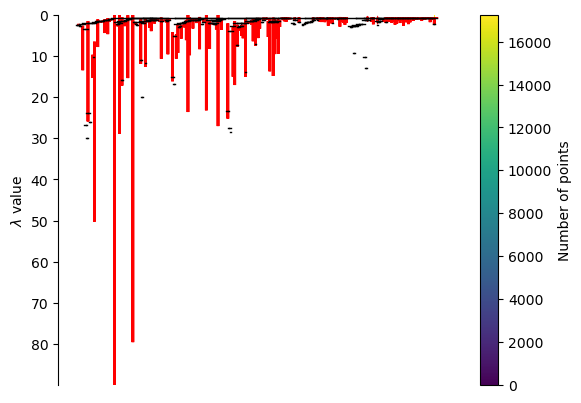

In [57]:
#clusterer = hdbscan.HDBSCAN(min_cluster_size=5, gen_min_span_tree=True)
#clusterer.fit(X)
#clusterer.condensed_tree_.plot(select_clusters=True, selection_palette=sns.color_palette()) 

### pca (n=3) + hdbscan

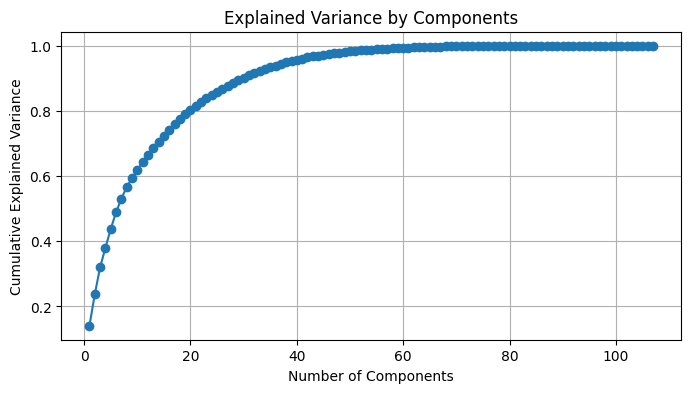

In [6]:
pca_test = PCA()
pca_test.fit(X)

cumulative_variance = pca_test.explained_variance_ratio_.cumsum()

plt.figure(figsize=(8, 4))
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance by Components')
plt.grid(True)
plt.show()

In [7]:
# reduce to 20 dimensions using pca, then try clustering
n_components = 20
pca_m = PCA(n_components=n_components)
pca = pca_m.fit_transform(X)

X_pca = pd.DataFrame(pca, columns = [f'PC-{i+1}' for i in range(n_components)])
# X_pca['y'] = y.values

scaler = MinMaxScaler()
X_pca_scaled = scaler.fit_transform(X_pca)

X_pca_scaled = pd.DataFrame(X_pca_scaled, columns=[f'PC-{i+1}-Scaled' for i in range(n_components)])
X_pca_scaled['y'] = y.values

X_pca_features = X_pca_scaled.iloc[:, :-1]

#
plot_3d_original(X_pca_scaled, 'PC-4-Scaled', 'PC-5-Scaled','PC-6-Scaled', "pca")

explained_variance = pd.DataFrame({
    'PC': [f'PC{i+1}' for i in range(n_components)],
    'Variance Explained': pca_m.explained_variance_ratio_
})
    

# create a df for the components of each principal component
components = pd.DataFrame(
    pca_m.components_[:3], 
    columns=X.columns, 
    index=[f'PC{i+1}' for i in range(3)]
)

sorted_columns = components.loc['PC1'].abs().sort_values(ascending=False).index
components_sorted = components[sorted_columns]

components_sorted_transposed = components_sorted.transpose()

print("Explained Variance per Component:")
print(explained_variance[:6])
print("\nPrincipal Components Loadings:")
print(components_sorted_transposed[:6])

Explained Variance per Component:
    PC  Variance Explained
0  PC1            0.140774
1  PC2            0.096410
2  PC3            0.082584
3  PC4            0.060317
4  PC5            0.057123
5  PC6            0.051872

Principal Components Loadings:
                             PC1       PC2       PC3
customer_segment_SMB    0.605192 -0.229434 -0.208957
ms_flag                 0.359338 -0.050828  0.092711
mfp_flag                0.333428  0.058452  0.259088
a3_c_flag               0.285797  0.024584  0.207765
win                     0.188787  0.063912  0.131760
sales_stage_status_Won  0.188787  0.063912  0.131760


In [8]:
# create a df for the components of each principal component
components = pd.DataFrame(
    pca_m.components_[:3], 
    columns=X.columns, 
    index=[f'PC{i+1}' for i in range(3)]
)

sorted_columns = components.loc['PC1'].abs().sort_values(ascending=False).index
components_sorted = components[sorted_columns]

components_sorted_transposed = components_sorted.transpose()

print("Explained Variance per Component:")
print(explained_variance[:6])
print("\nPrincipal Components Loadings:")
print(components_sorted_transposed[:5])

Explained Variance per Component:
    PC  Variance Explained
0  PC1            0.140774
1  PC2            0.096410
2  PC3            0.082584
3  PC4            0.060317
4  PC5            0.057123
5  PC6            0.051872

Principal Components Loadings:
                           PC1       PC2       PC3
customer_segment_SMB  0.605192 -0.229434 -0.208957
ms_flag               0.359338 -0.050828  0.092711
mfp_flag              0.333428  0.058452  0.259088
a3_c_flag             0.285797  0.024584  0.207765
win                   0.188787  0.063912  0.131760


In [9]:
# components_sorted.iloc[2,].sort_values(key = abs, ascending = False).head(20)
# components_sorted.iloc[0,].sort_values(key = abs, ascending = False).head(20)

customer_segment_SLG                                           0.487545
crm_industry_SLG                                               0.485762
crm_industry_Manufacturing, Related Distributors & Services   -0.331320
mfp_flag                                                       0.259088
department_Unknown                                            -0.240677
job_type_Unknown                                              -0.235476
customer_segment_SMB                                          -0.208957
a3_c_flag                                                      0.207765
customer_segment_Commercial Print                             -0.140722
sales_stage_status_Won                                         0.131760
win                                                            0.131760
sales_stage_status_No Sale                                    -0.131754
department_Administration                                      0.123564
customer_segment_Targeted                                     -0

In [9]:
# plot principle component weights 
components_long = components_sorted.reset_index().melt(id_vars='index', var_name='Feature', value_name='Value')

fig = px.bar(components_long, x='Feature', y='Value', color='index', barmode='group',
             title='PCA Component Weights',
             labels={'index': 'Principal Component', 'Feature': 'Feature', 'Value': 'Weight'})

fig.update_layout(legend_title_text='Click to show/hide:', legend=dict(traceorder='normal', itemsizing='constant'))
fig.update_xaxes(categoryorder='total descending')

fig.show()
fig.write_html('pca_components_plot.html')

In [10]:
# skip - fine tune
eps_list = [0.2, 0.3, 0.5, 0.7]
min_sample_list = [30, 50, 60, 75, 100, 120, 150, 200, 300, 500]

# eps_list = [1.5, 1.2]
# min_sample_list = [15, 30, 50, 60, 75, 100, 120, 150, 200, 300]

silhouette_avg_scores = []
param_pair = []

X_pca_features = X_pca_scaled.iloc[:, :-1]

for eps in eps_list:
    for min_sample in min_sample_list: 
        param_pair.append((eps, min_sample))
        dbscan = DBSCAN(eps=eps, min_samples=min_sample)  
        cluster_labels = dbscan.fit_predict(X_pca_features)
        # 
        if len(set(cluster_labels)) == 1:
            continue
        
        silhouette_avg = silhouette_score(X_pca_features, cluster_labels)
        silhouette_avg_scores.append(silhouette_avg)
        print(f"For eps = {eps}, min_sample = {min_sample}: the average silhouette score is : {silhouette_avg}")

For eps = 0.2, min_sample = 30: the average silhouette score is : -0.17346158314467008
For eps = 0.2, min_sample = 50: the average silhouette score is : -0.19067657537359572
For eps = 0.2, min_sample = 60: the average silhouette score is : -0.15536533086421733
For eps = 0.2, min_sample = 75: the average silhouette score is : -0.1350223045429204
For eps = 0.2, min_sample = 100: the average silhouette score is : -0.06556644495184792
For eps = 0.2, min_sample = 120: the average silhouette score is : -0.053327348160374426
For eps = 0.2, min_sample = 150: the average silhouette score is : -0.07193193342864755
For eps = 0.3, min_sample = 30: the average silhouette score is : 0.11810337229507954
For eps = 0.3, min_sample = 50: the average silhouette score is : 0.07907893823922887
For eps = 0.3, min_sample = 60: the average silhouette score is : 0.06473126344858691
For eps = 0.3, min_sample = 75: the average silhouette score is : 0.03722605010645539
For eps = 0.3, min_sample = 100: the average

In [8]:
clusterer_pca = hdbscan.HDBSCAN(min_cluster_size=10, min_samples=50)
X_pca_scaled['hdbscan_label'] = clusterer_pca.fit_predict(X_pca_features)
plot_3d(X_pca_scaled, "PC-1-Scaled", "PC-2-Scaled", "PC-3-Scaled", "pca", "hdbscan")
#plot_3d(X_pca_scaled, "PC-4-Scaled", "PC-5-Scaled", "PC-6-Scaled", "pca", "hdbscan")

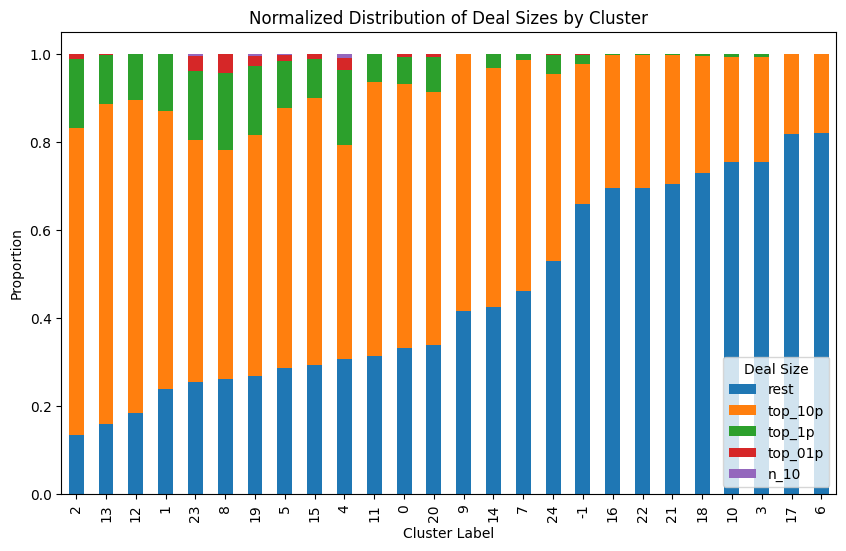

In [9]:
plot_cluster_hist(X_pca_scaled, 'hdbscan') # cluster 4 

In [10]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_pca_scaled, 'hdbscan', 4)
#plot_summary(most_different_features, db2_summary, dbo_summary, 1)
#plot_summary(least_different_features, db2_summary, dbo_summary, 1)

job_type_Consultant                   -200.000000
job_type_Owner / Principal            -193.983904
cs                                    -189.908469
department_Sales                      -186.452062
wf_bw_flag                            -184.059064
mindshift_flag                        -181.965207
rent                                   180.828741
mif                                    175.848063
department_Supply Chain / Logistics    169.877409
Name: mean, dtype: float64
mfp_flag                                  -13.685762
department_Engineering                    -11.341808
sales_dnb                                  -8.525469
job_type_Associate / Analyst / Coordina     7.618535
department_Customer Service / Support       7.472592
close_days                                  5.625831
sales_stage_status_Won                     -0.030019
win                                        -0.030019
sales_stage_status_No Sale                  0.018041
sales_stage_status_Lost                       

## T-SNE

### n = 2

In [11]:
tsne = TSNE(n_components=2, random_state = 1208).fit_transform(X)

<Figure size 1000x800 with 0 Axes>

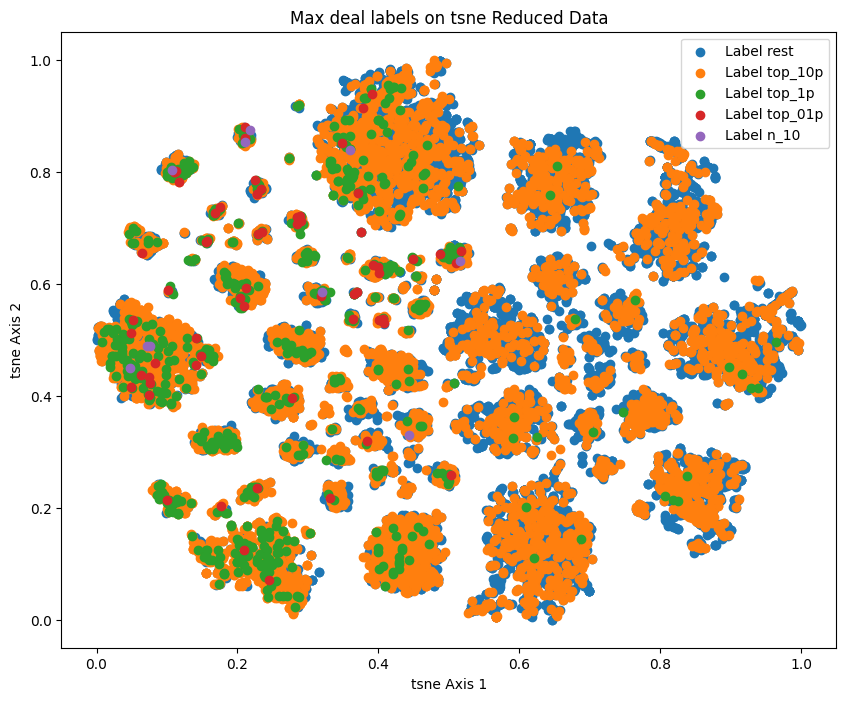

In [12]:
plt.figure(figsize=(10, 8))

X_tsne = pd.DataFrame(tsne, columns=['TSNE-1', 'TSNE-2'])
X_tsne['y'] = y.values

# scale 
scaler = MinMaxScaler()
X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']] = scaler.fit_transform(X_tsne[['TSNE-1', 'TSNE-2']])

plot_2d_original(X_tsne, 'TSNE-1-Scaled', 'TSNE-2-Scaled', "tsne")

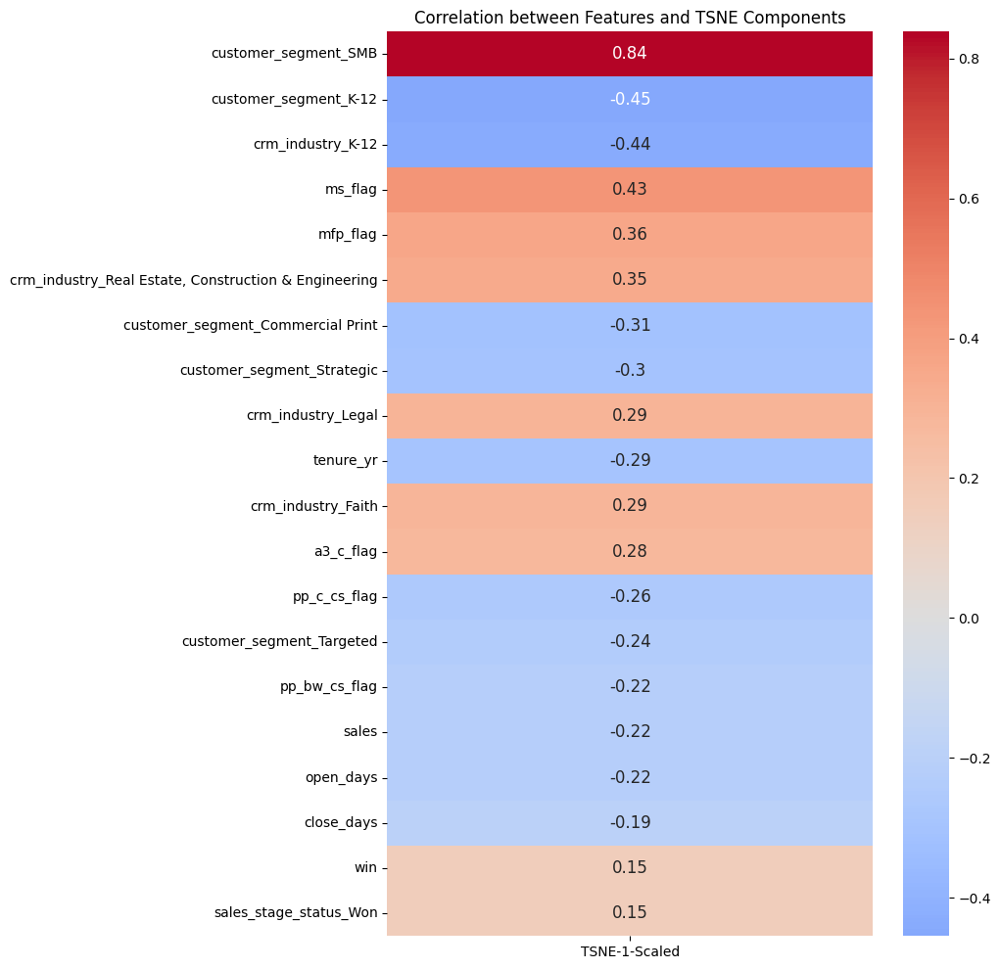

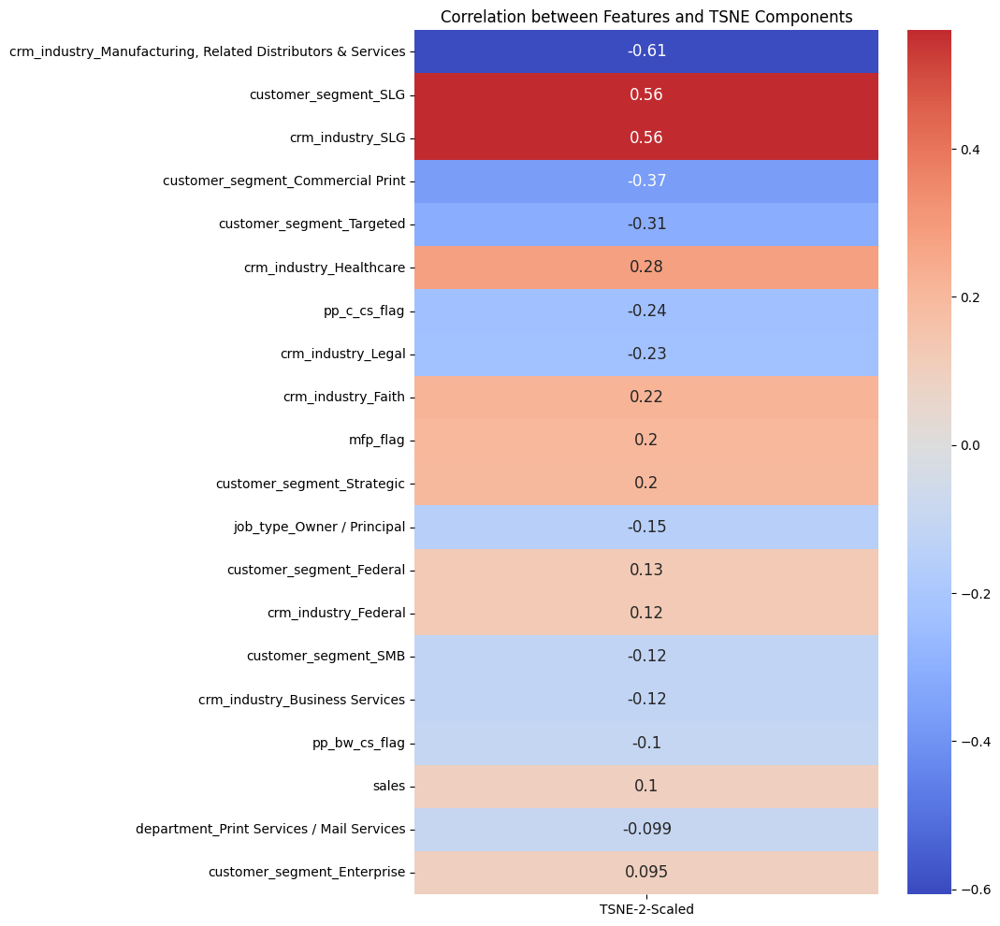

In [13]:
# plot correlation of features and umap coordimates 3d -- sort by abs values
tsne_df = pd.concat([X_features.reset_index(drop=True), X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']]], axis=1)
tsne_corr = tsne_df.corr().loc[:, 'TSNE-1-Scaled':'TSNE-2-Scaled'].drop(['TSNE-1-Scaled', 'TSNE-2-Scaled'])

# print(umap_corr)
for i in range(1, 3):  
    plt.figure(figsize=(8, 12))
    axis = 'TSNE-' + str(i) + '-Scaled'
    sns.heatmap(tsne_corr[[axis]].sort_values(by = axis, key=abs, ascending = False).head(20), annot=True, cmap='coolwarm', center=0, annot_kws={"size": 12})
    plt.title('Correlation between Features and TSNE Components')
    plt.show()

### tnse (n = 2) + kmeans

For n_clusters = 2, the average silhouette score is : 0.3441084623336792
For n_clusters = 3, the average silhouette score is : 0.383152037858963
For n_clusters = 4, the average silhouette score is : 0.38600489497184753
For n_clusters = 5, the average silhouette score is : 0.3810340166091919
For n_clusters = 6, the average silhouette score is : 0.41588127613067627
For n_clusters = 7, the average silhouette score is : 0.397344172000885
For n_clusters = 8, the average silhouette score is : 0.4138227701187134
For n_clusters = 9, the average silhouette score is : 0.41794082522392273
For n_clusters = 10, the average silhouette score is : 0.42141562700271606
For n_clusters = 11, the average silhouette score is : 0.43059372901916504
For n_clusters = 12, the average silhouette score is : 0.43860331177711487
For n_clusters = 13, the average silhouette score is : 0.4471612274646759
For n_clusters = 14, the average silhouette score is : 0.4555749297142029
For n_clusters = 15, the average silhouett

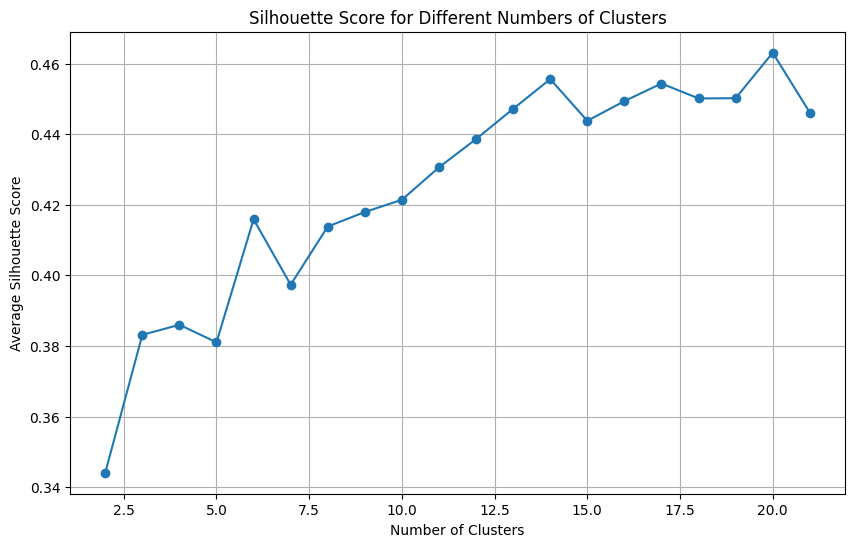

In [16]:
n_cluster = list(range(2,22))

silhouette_avg_scores = []

for n_clusters in n_cluster:
    clusterer = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = clusterer.fit_predict(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']])
    
    silhouette_avg = silhouette_score(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']], cluster_labels)
    silhouette_avg_scores.append(silhouette_avg)
    print(f"For n_clusters = {n_clusters}, the average silhouette score is : {silhouette_avg}")

# 
plt.figure(figsize=(10, 6))
plt.plot(n_cluster, silhouette_avg_scores, marker='o')
plt.title('Silhouette Score for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Average Silhouette Score')
plt.grid(True)
plt.show()

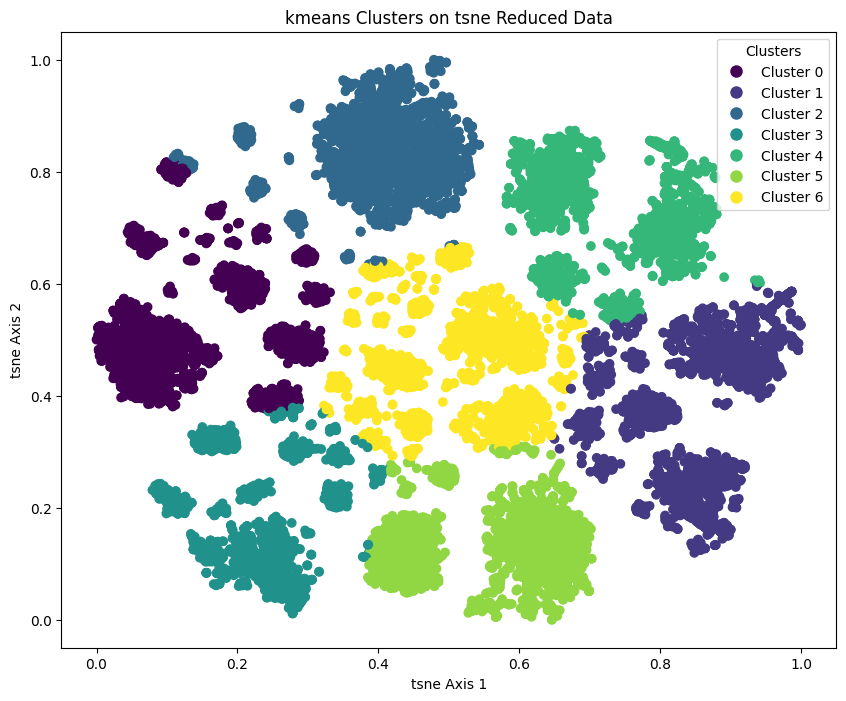

In [14]:
kmeans = KMeans(n_clusters=7, random_state=0, n_init="auto").fit(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']])
kmeans_labels = kmeans.labels_
X_tsne['kmeans_label'] = kmeans.labels_
plot_2d(X_tsne, 'TSNE-1-Scaled', 'TSNE-2-Scaled', "tsne", "kmeans")

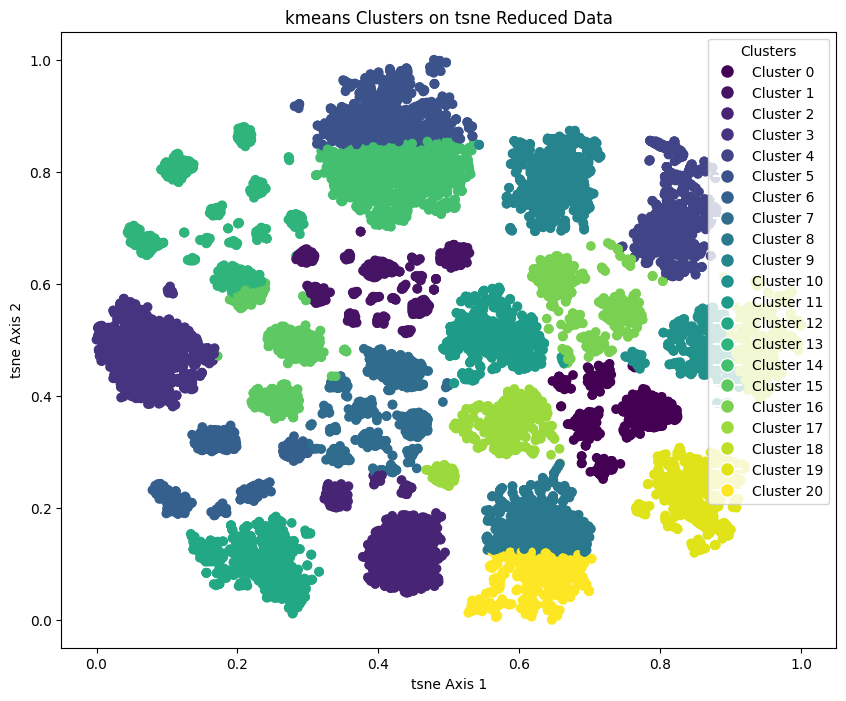

In [15]:
kmeans = KMeans(n_clusters=21, random_state=123, n_init="auto").fit(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']])
kmeans_labels = kmeans.labels_
X_tsne['kmeans_label'] = kmeans.labels_
plot_2d(X_tsne, 'TSNE-1-Scaled', 'TSNE-2-Scaled', "tsne", "kmeans")

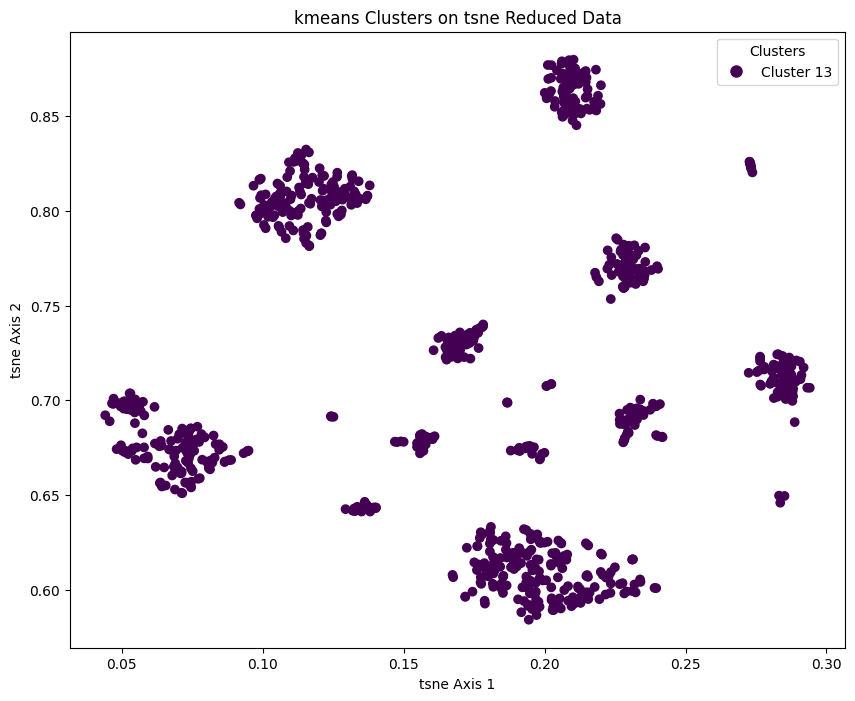

In [20]:
plot_2d(X_tsne[X_tsne.kmeans_label == 13], 'TSNE-1-Scaled', 'TSNE-2-Scaled', "tsne", "kmeans")

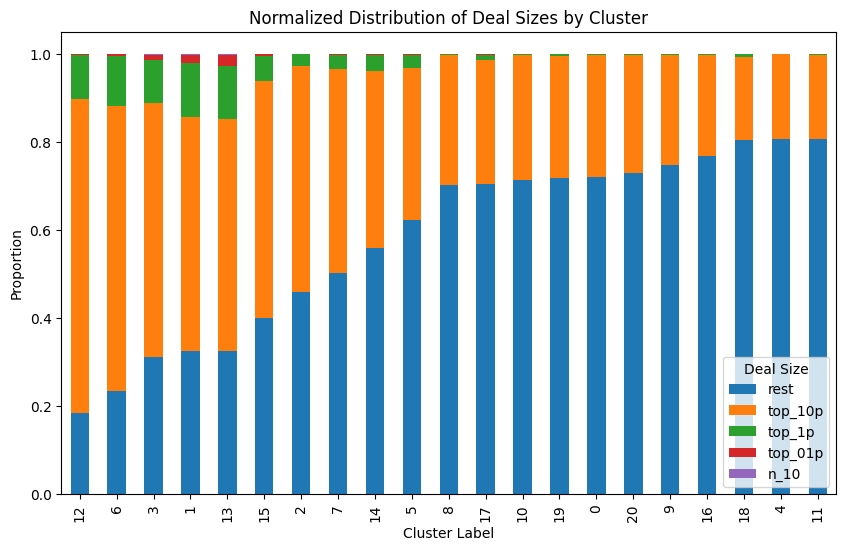

In [17]:
label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
ctab_normalized = pd.crosstab(X_tsne['kmeans_label'], X_tsne['y'], normalize='index')[label_plot].sort_values(by = "rest")

# Plot a normalized bar chart
ctab_normalized.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Normalized Distribution of Deal Sizes by Cluster')
plt.xlabel('Cluster Label')
plt.ylabel('Proportion')
plt.legend(title='Deal Size')
plt.show()

In [18]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_tsne, 'kmeans', 13)

sales_stage_status_Open   -200.000000
cs                         199.032826
ms off                     189.023494
ms on                      175.766522
mif                        175.620385
sales_dnb                  173.816061
employees_dnb              170.788752
ps                         168.744986
renewal                    167.958062
Name: mean, dtype: float64
pp_bw_cs_flag                   -10.716240
job_type_Consultant             -10.299700
job_type_Manager / Supervisor     8.932046
a4_bw_flag                        8.118796
pp_c_cs_flag                     -3.399714
sales_stage_status_No Sale        2.880280
close_days                       -2.531276
sales_stage_status_Won           -1.946678
win                              -1.946678
sales_stage_status_Lost                NaN
Name: mean, dtype: float64


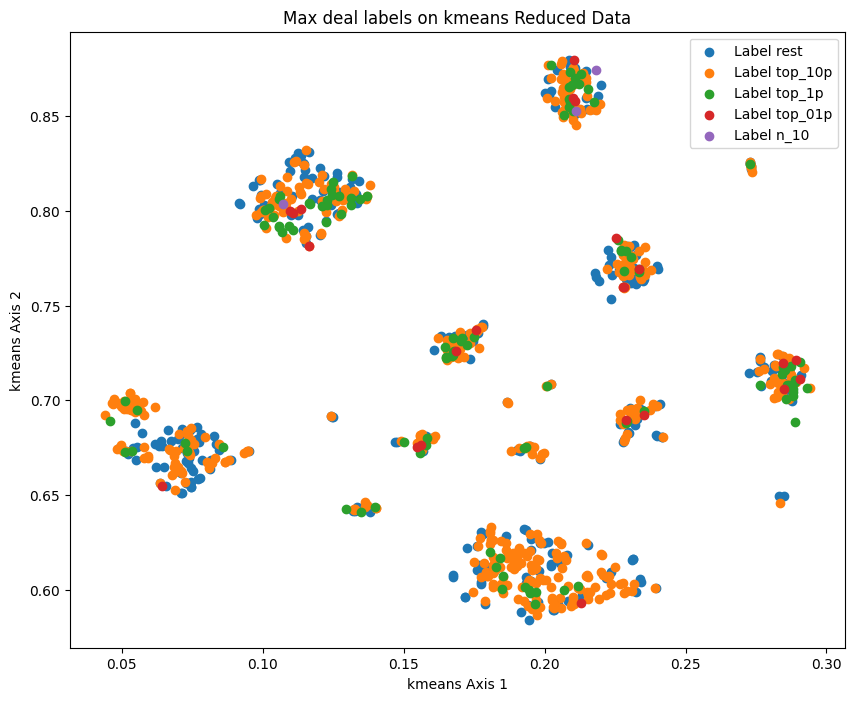

In [19]:
cluster_num = 13
cluster_sample = X_tsne[X_tsne['kmeans_label'] == cluster_num]
plot_2d_original(cluster_sample, 'TSNE-1-Scaled', 'TSNE-2-Scaled', 'kmeans')

### tnse (n = 2) + dbscan

In [26]:
eps_list = [0.025, 0.03, 0.04]
min_sample_list = [15, 20, 25, 30, 50, 60, 100]

silhouette_avg_scores = []
param_pair = []

for eps in eps_list:
    for min_sample in min_sample_list: 
        param_pair.append((eps, min_sample))
        dbscan = DBSCAN(eps=eps, min_samples=min_sample)  
        cluster_labels = dbscan.fit_predict(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']])
        # 
        silhouette_avg = silhouette_score(X_tsne[['TSNE-1', 'TSNE-2']], cluster_labels)
        silhouette_avg_scores.append(silhouette_avg)
        print(f"For eps = {eps}, min_sample = {min_sample}: the average silhouette score is : {silhouette_avg}")

For eps = 0.025, min_sample = 15: the average silhouette score is : 0.36759519577026367
For eps = 0.025, min_sample = 20: the average silhouette score is : 0.3666021525859833
For eps = 0.025, min_sample = 25: the average silhouette score is : 0.35683825612068176
For eps = 0.025, min_sample = 30: the average silhouette score is : 0.3695032596588135
For eps = 0.025, min_sample = 50: the average silhouette score is : 0.4035695791244507
For eps = 0.025, min_sample = 60: the average silhouette score is : 0.37019142508506775
For eps = 0.025, min_sample = 100: the average silhouette score is : 0.1502659022808075
For eps = 0.03, min_sample = 15: the average silhouette score is : 0.29233458638191223
For eps = 0.03, min_sample = 20: the average silhouette score is : 0.38136056065559387
For eps = 0.03, min_sample = 25: the average silhouette score is : 0.390095978975296
For eps = 0.03, min_sample = 30: the average silhouette score is : 0.39522162079811096
For eps = 0.03, min_sample = 50: the aver

[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36]


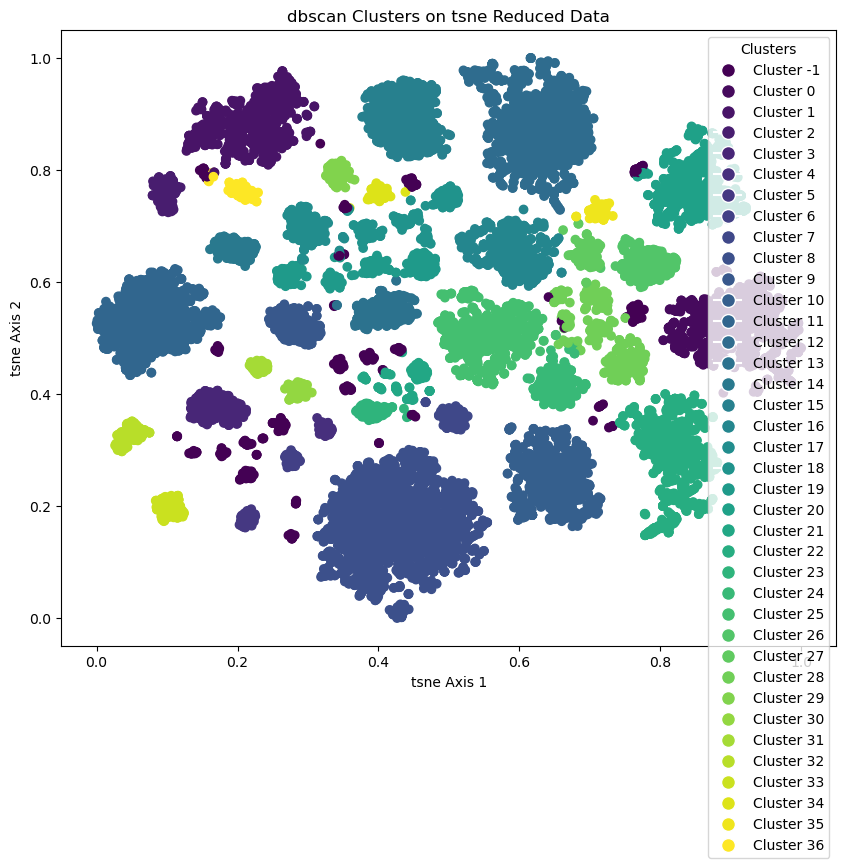

0.41306382

In [27]:
dbscan = DBSCAN(eps=0.03, min_samples=60)  # eps and min_samples need to be adjusted based on your data
dbscan_labels = dbscan.fit_predict(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']])
X_tsne['dbscan_label'] = dbscan_labels
print(np.unique(dbscan_labels))
plot_2d(X_tsne, 'TSNE-1-Scaled','TSNE-2-Scaled', "tsne", "dbscan")

shs(X_tsne[['TSNE-1-Scaled', 'TSNE-2-Scaled']], X_tsne['dbscan_label'])

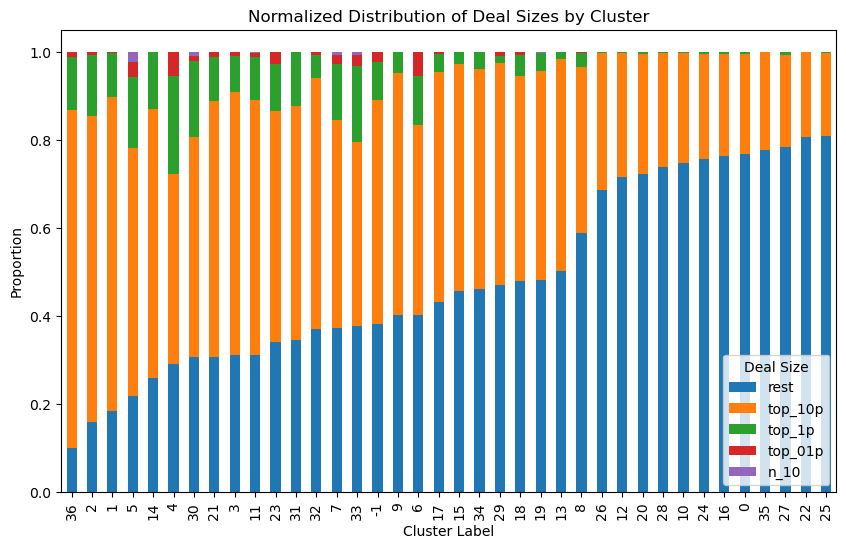

In [28]:
label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
ctab_normalized = pd.crosstab(X_tsne['dbscan_label'], X_tsne['y'], normalize='index')[label_plot].sort_values(by = "rest")

# Plot a normalized bar chart
ctab_normalized.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Normalized Distribution of Deal Sizes by Cluster')
plt.xlabel('Cluster Label')
plt.ylabel('Proportion')
plt.legend(title='Deal Size')
plt.show()

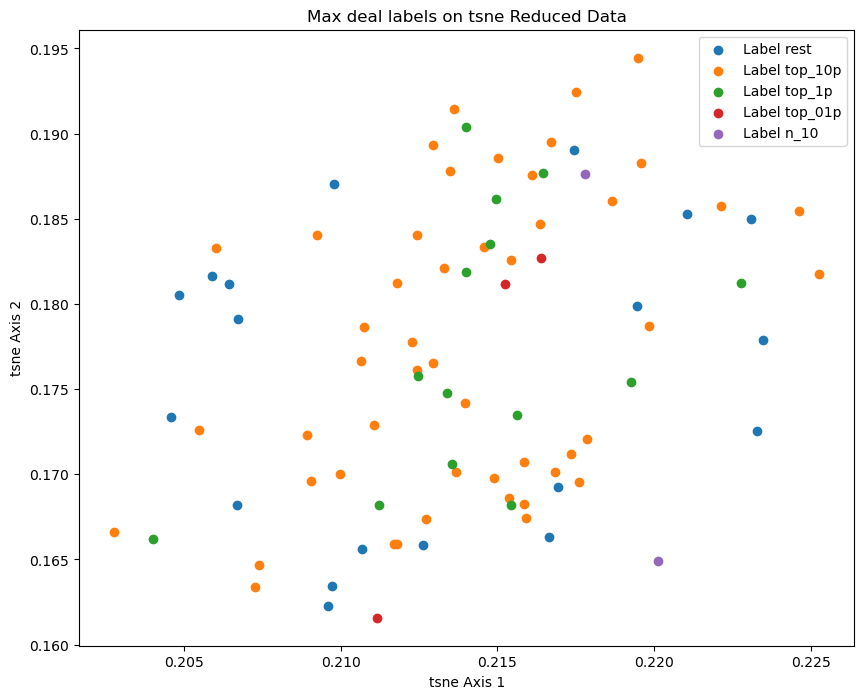

In [29]:
plot_2d_original(X_tsne[X_tsne.dbscan_label == 5], 'TSNE-1-Scaled', 'TSNE-2-Scaled', "tsne")

In [33]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_tsne, 'dbscan', 5)

sales_stage_status_Open   -200.000000
cs                         199.908771
ms on                      184.063689
employees_dnb              183.761067
sales_dnb                  183.746729
order                      181.888876
quote                      179.608590
ps                         178.337158
opp                        177.467158
Name: mean, dtype: float64
department_Information Technology / Secur    14.233034
sales_stage_status_Won                      -10.961769
win                                         -10.961769
job_type_Unknown                             10.125066
close_days                                    9.728453
department_Legal                             -9.495644
kmeans_label_3d                               9.138073
department_Unknown                            7.692050
department_Operations / Compliance / Reco    -7.455692
sales_stage_status_Lost                            NaN
Name: mean, dtype: float64


### n = 3

In [34]:
tsne_3d = TSNE(n_components=3, random_state=123).fit_transform(X)

X_tsne_3d = pd.DataFrame(tsne_3d, columns=['TSNE-1', 'TSNE-2', 'TSNE-3'])
X_tsne_3d['y'] = y.values

# scale 
scaler = MinMaxScaler()
X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled']] = scaler.fit_transform(X_tsne_3d[['TSNE-1', 'TSNE-2', 'TSNE-3']])

### tsne (n=3) + kmeans

For n_clusters = 16, the average silhouette score is : 0.3856516480445862
For n_clusters = 17, the average silhouette score is : 0.39043691754341125
For n_clusters = 18, the average silhouette score is : 0.39155760407447815
For n_clusters = 19, the average silhouette score is : 0.3715987205505371
For n_clusters = 20, the average silhouette score is : 0.37887588143348694
For n_clusters = 21, the average silhouette score is : 0.3855952024459839
For n_clusters = 22, the average silhouette score is : 0.3801422715187073
For n_clusters = 23, the average silhouette score is : 0.3778478503227234
For n_clusters = 24, the average silhouette score is : 0.3791571855545044
For n_clusters = 25, the average silhouette score is : 0.3825284242630005
For n_clusters = 26, the average silhouette score is : 0.3790307641029358
For n_clusters = 27, the average silhouette score is : 0.38233935832977295
For n_clusters = 28, the average silhouette score is : 0.37968096137046814
For n_clusters = 29, the average 

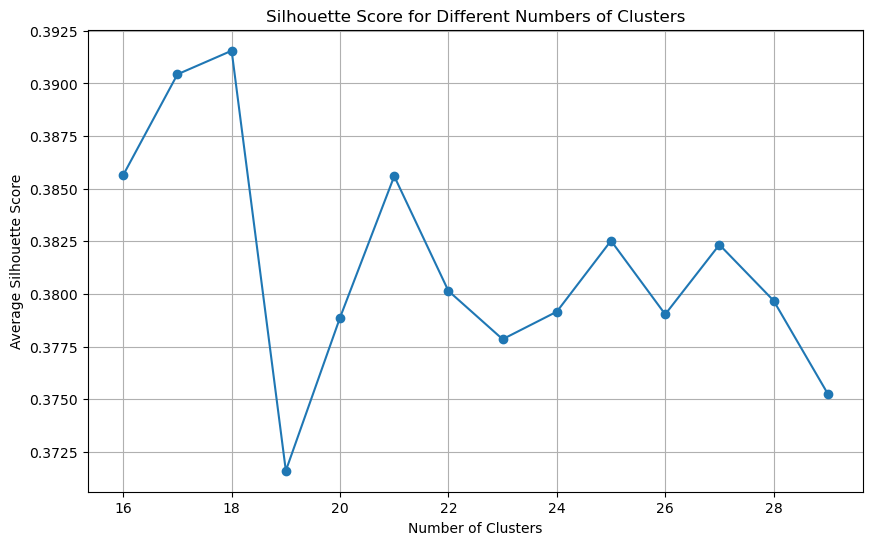

In [35]:
n_cluster = list(range(16, 30))

silhouette_avg_scores = []

for n_clusters in n_cluster:
    clusterer = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = clusterer.fit_predict(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled']])
    
    silhouette_avg = silhouette_score(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled']], cluster_labels)
    silhouette_avg_scores.append(silhouette_avg)
    print(f"For n_clusters = {n_clusters}, the average silhouette score is : {silhouette_avg}")

# Plotting the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(n_cluster, silhouette_avg_scores, marker='o')
plt.title('Silhouette Score for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Average Silhouette Score')
plt.grid(True)
plt.show()

In [36]:
plot_3d_original(X_tsne_3d, 'TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled', 'tsne')

In [37]:
kmeans = KMeans(n_clusters=24, random_state=0, n_init="auto").fit(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled']])
kmeans_labels = kmeans.labels_
X_tsne_3d['kmeans_label'] = kmeans.labels_
plot_3d(X_tsne_3d, 'TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled', "tsne", "kmeans")

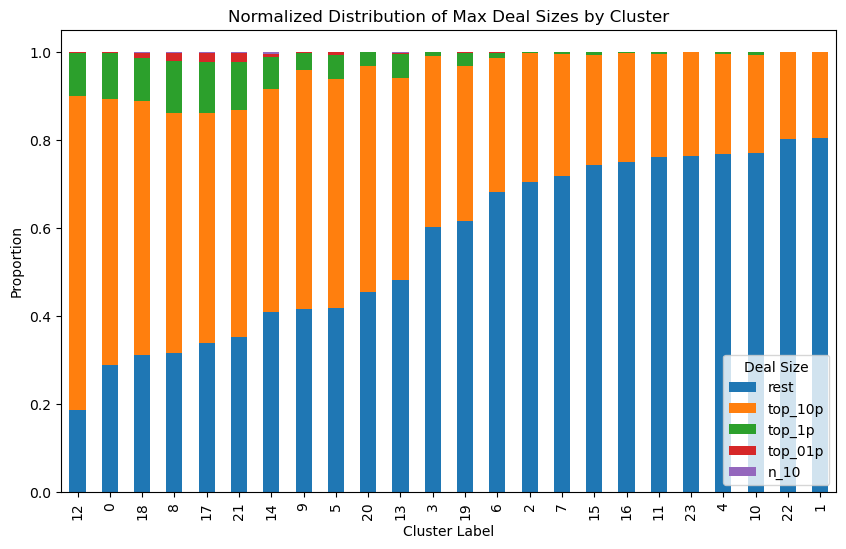

In [38]:
label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
ctab_normalized = pd.crosstab(X_tsne_3d['kmeans_label'], X_tsne_3d['y'], normalize='index')[label_plot].sort_values(by = "rest")

ctab_normalized.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Normalized Distribution of Max Deal Sizes by Cluster')
plt.xlabel('Cluster Label')
plt.ylabel('Proportion')
plt.legend(title='Deal Size')
plt.show()

In [40]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_tsne_3d, 'kmeans', 17)

sales_stage_status_Open                   -200.000000
cs                                        -194.920278
ms on                                      135.556613
department_Environmental Sustainability    135.034944
ps                                         134.143972
renewal                                    133.392835
employees_dnb                              133.222210
supp                                      -128.406361
sales                                      121.642645
Name: mean, dtype: float64
color_lp_flag                       5.926485
department_Facilities Management    5.730696
job_type_Manager / Supervisor      -4.920533
a3_c_flag                          -4.686671
department_Legal                   -3.601617
its                                 3.250992
ransomcare_flag                    -1.847713
close_days                          1.094123
a4_c_flag                          -0.843870
sales_stage_status_Lost                  NaN
Name: mean, dtype: float64


### tsne(n=3) + DBSCAN

In [41]:
eps_list = [0.04, 0.05, 0.06, 0.1]
min_sample_list = [10, 15, 20, 25, 30, 50]

silhouette_avg_scores = []
param_pair = []

for eps in eps_list:
    for min_sample in min_sample_list: 
        param_pair.append((eps, min_sample))
        dbscan = DBSCAN(eps=eps, min_samples=min_sample)  
        cluster_labels = dbscan.fit_predict(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled','TSNE-3-Scaled']])
        # 
        if all(label == -1 for label in cluster_labels):
            continue
        silhouette_avg = silhouette_score(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled','TSNE-3-Scaled']], cluster_labels)
        silhouette_avg_scores.append(silhouette_avg)
        print(f"For eps = {eps}, min_sample = {min_sample}: the average silhouette score is : {silhouette_avg}")

For eps = 0.04, min_sample = 10: the average silhouette score is : 0.15933239459991455
For eps = 0.04, min_sample = 15: the average silhouette score is : 0.24941052496433258
For eps = 0.04, min_sample = 20: the average silhouette score is : 0.28339099884033203
For eps = 0.04, min_sample = 25: the average silhouette score is : 0.25878387689590454
For eps = 0.04, min_sample = 30: the average silhouette score is : 0.2528722286224365
For eps = 0.04, min_sample = 50: the average silhouette score is : 0.018569037318229675
For eps = 0.05, min_sample = 10: the average silhouette score is : 0.10447385907173157
For eps = 0.05, min_sample = 15: the average silhouette score is : 0.21670983731746674
For eps = 0.05, min_sample = 20: the average silhouette score is : 0.23474568128585815
For eps = 0.05, min_sample = 25: the average silhouette score is : 0.2666519582271576
For eps = 0.05, min_sample = 30: the average silhouette score is : 0.32642075419425964
For eps = 0.05, min_sample = 50: the average

[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46
 47 48 49 50 51 52]


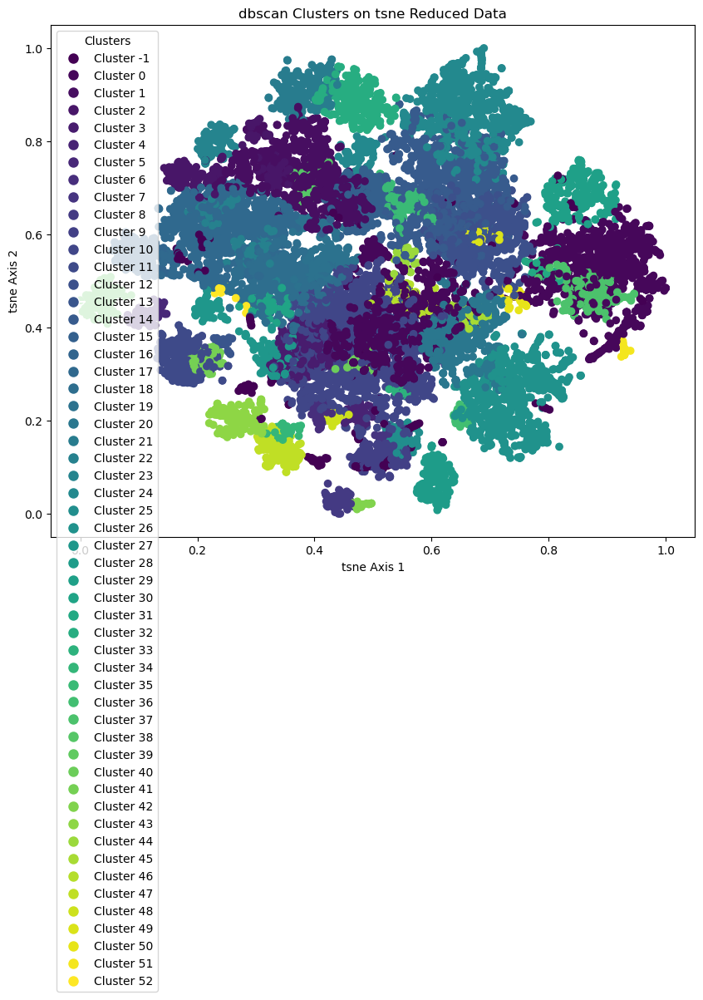

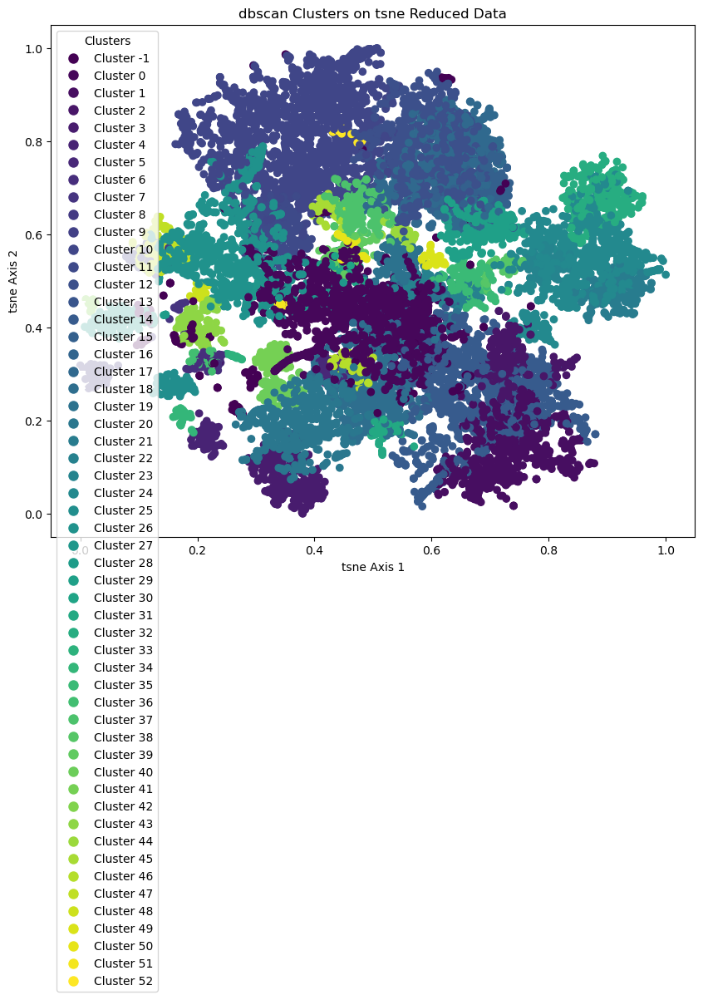

In [42]:
dbscan = DBSCAN(eps=0.05, min_samples=25)  # eps and min_samples need to be adjusted based on your data
dbscan_labels = dbscan.fit_predict(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled']])
X_tsne_3d['dbscan_label'] = dbscan_labels
print(np.unique(dbscan_labels))
plot_2d(X_tsne_3d, 'TSNE-1-Scaled','TSNE-2-Scaled', "tsne", "dbscan")
plot_2d(X_tsne_3d, 'TSNE-2-Scaled','TSNE-3-Scaled', "tsne", "dbscan")
# shs(X_tsne_3d[['TSNE-1-Scaled', 'TSNE-2-Scaled', 'TSNE-3-Scaled']], X_tsne_3d['dbscan_label'])

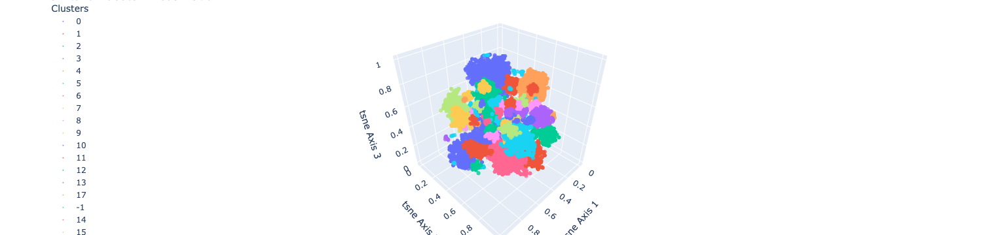

In [43]:
plot_3d(X_tsne_3d, 'TSNE-1-Scaled', 'TSNE-2-Scaled','TSNE-3-Scaled', "tsne", "dbscan")

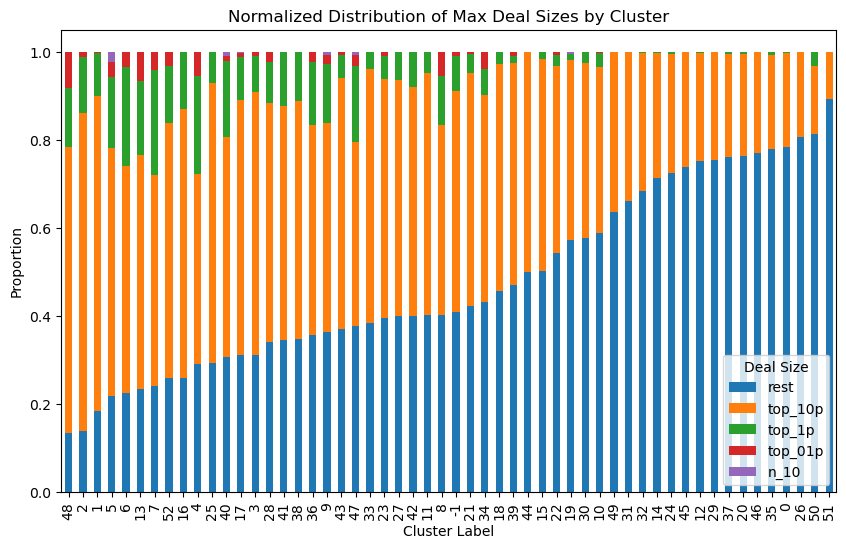

In [44]:
label_plot = ['rest', 'top_10p','top_1p', 'top_01p', 'n_10']
ctab_normalized = pd.crosstab(X_tsne_3d['dbscan_label'], X_tsne_3d['y'], normalize='index')[label_plot].sort_values(by = "rest")

ctab_normalized.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Normalized Distribution of Max Deal Sizes by Cluster')
plt.xlabel('Cluster Label')
plt.ylabel('Proportion')
plt.legend(title='Deal Size')
plt.show()

In [45]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_tsne_3d, 'dbscan', 5)

sales_stage_status_Open   -200.000000
cs                         199.908771
ms on                      184.063689
employees_dnb              183.761067
sales_dnb                  183.746729
order                      181.888876
quote                      179.608590
ps                         178.337158
opp                        177.467158
Name: mean, dtype: float64
sales_stage_status_No Sale                   14.572460
department_Information Technology / Secur    14.233034
sales_stage_status_Won                      -10.961769
win                                         -10.961769
job_type_Unknown                             10.125066
close_days                                    9.728453
department_Legal                             -9.495644
department_Unknown                            7.692050
department_Operations / Compliance / Reco    -7.455692
sales_stage_status_Lost                            NaN
Name: mean, dtype: float64


## UMAP

### n = 2

In [46]:
umap = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=2, random_state=42).fit_transform(X)

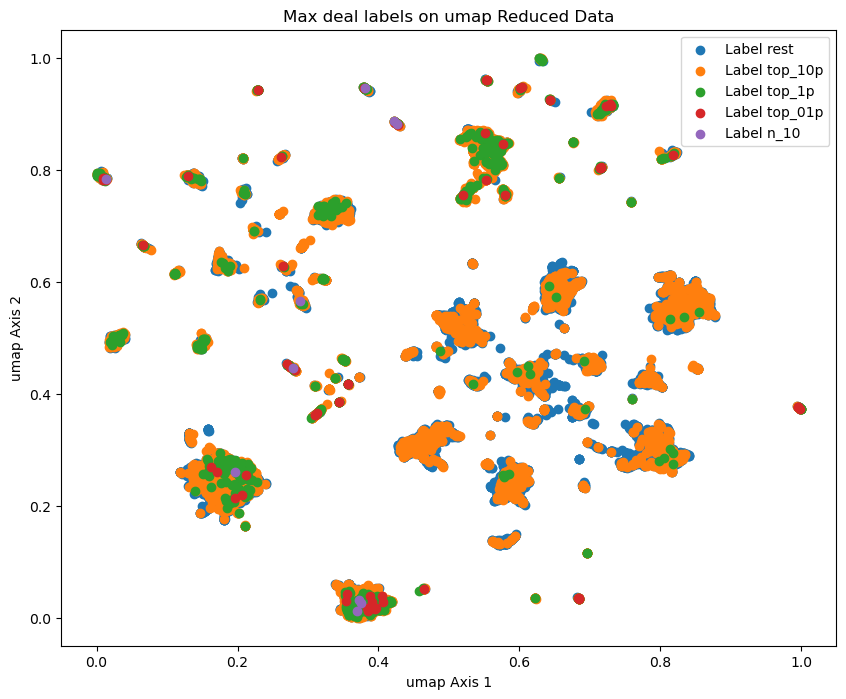

In [47]:
X_umap = pd.DataFrame(umap, columns=['UMAP-1', 'UMAP-2'])
X_umap['y'] = y.values

scaler = MinMaxScaler()
X_umap[['UMAP-1-Scaled', 'UMAP-2-Scaled']] = scaler.fit_transform(X_umap[['UMAP-1', 'UMAP-2']])
X_umap_scaled = X_umap[['UMAP-1-Scaled', 'UMAP-2-Scaled']]
plot_2d_original(X_umap, 'UMAP-1-Scaled', 'UMAP-2-Scaled', 'umap')

In [48]:
# fine tune 

hdb = hdbscan.HDBSCAN(gen_min_span_tree=True).fit(X_umap_scaled)

param_dist = {'min_samples': [60,80,100,120,150,200],
              'min_cluster_size':[200,250,300,350,400],  
              'cluster_selection_method' : ['eom','leaf'],
              'metric' : ['euclidean','manhattan'] 
             }

validity_scorer = make_scorer(hdbscan.validity.validity_index,greater_is_better=True)


n_iter_search = 20
random_search = RandomizedSearchCV(hdb
                                   ,param_distributions=param_dist
                                   ,n_iter=n_iter_search
                                   ,scoring=validity_scorer 
                                   ,random_state=42)

random_search.fit(X_umap_scaled)


print(f"Best Parameters {random_search.best_params_}")
print(f"DBCV score :{random_search.best_estimator_.relative_validity_}")

Best Parameters {'min_samples': 100, 'min_cluster_size': 300, 'metric': 'manhattan', 'cluster_selection_method': 'eom'}
DBCV score :0.35143257465507727


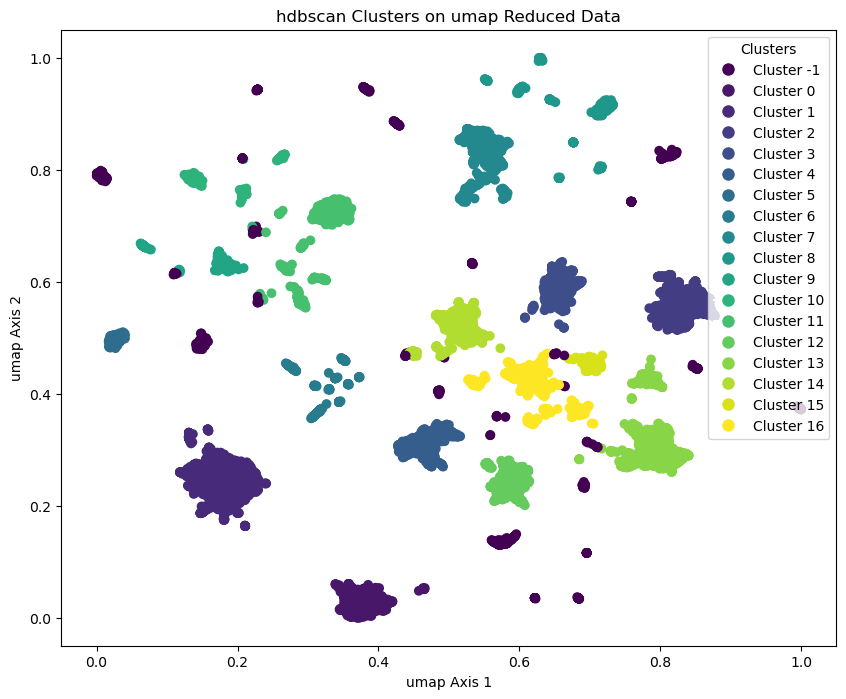

In [49]:
hdb = hdbscan.HDBSCAN(min_samples = 100, min_cluster_size=300, cluster_selection_method = 'eom', gen_min_span_tree=True)
hdb_cluster = hdb.fit(X_umap[['UMAP-1-Scaled', 'UMAP-2-Scaled']])
X_umap['hdbscan_label'] = hdb_cluster.labels_

plot_2d(X_umap, 'UMAP-1-Scaled', 'UMAP-2-Scaled', 'umap', 'hdbscan')

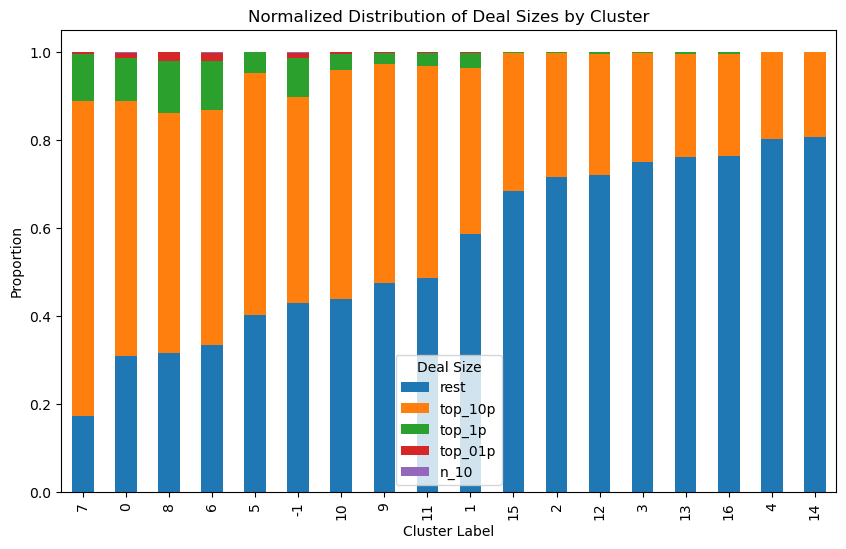

In [48]:
plot_cluster_hist(X_umap, 'hdbscan')

In [50]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_umap, 'hdbscan', 6)

cs                                    -175.390063
job_type_Owner / Principal            -174.888218
eloqua                                 158.856427
mindshift_flag                        -156.065757
department_Supply Chain / Logistics    152.261109
mif                                    149.786727
order                                  147.986043
rent                                   147.801562
web                                    144.468269
Name: mean, dtype: float64
sales_stage_status_Won             -8.455390
hdbscan_label_3d                   -7.986275
job_type_Unknown                    7.512927
wf_c_flag                           7.276156
department_Unknown                  6.418269
job_type_Technician                 6.298489
job_type_Manager / Supervisor       5.933830
department_Facilities Management    3.693290
dbscan_label_3d                    -0.423790
sales_stage_status_Lost                  NaN
Name: mean, dtype: float64


### n = 3

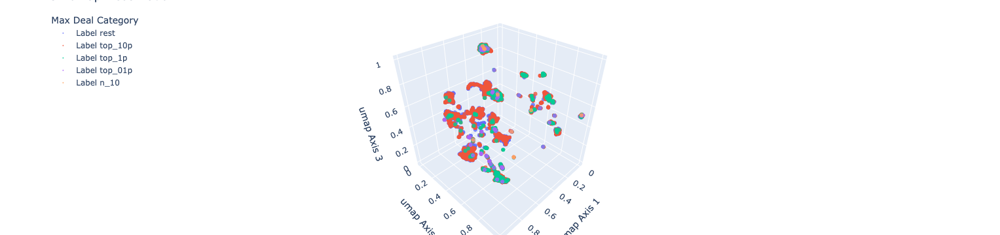

In [51]:
import umap.umap_ as umap
umap_3d = umap.UMAP(n_neighbors=15, min_dist=0.1, n_components=3, random_state=42).fit_transform(X)

X_umap_3d = pd.DataFrame(umap_3d, columns=['UMAP-1', 'UMAP-2', 'UMAP-3'])
X_umap_3d['y'] = y.values

scaler = MinMaxScaler()
X_umap_3d[['UMAP-1-Scaled', 'UMAP-2-Scaled', 'UMAP-3-Scaled']] = scaler.fit_transform(X_umap_3d[['UMAP-1', 'UMAP-2', 'UMAP-3']])
X_umap_3d_scaled = X_umap_3d[['UMAP-1-Scaled', 'UMAP-2-Scaled', 'UMAP-3-Scaled']]
plot_3d_original(X_umap_3d, 'UMAP-1-Scaled', 'UMAP-2-Scaled','UMAP-3-Scaled', 'umap')

In [52]:
top_01p_points = [(0.6462595, 0.8768139, 0.8134524), (0.6740317, 0.7701678, 0.1425704)]

Above example is 2 points from top 01p maxdeal group, strong diff in umap-3 
-- customer segment, flag, and job types
so if we look at their feature, they would be somewhat diff in that?
X_umap

In [53]:
X_umap_3d[(X_umap_3d['UMAP-1-Scaled'] >= 0.64625) & (X_umap_3d['UMAP-1-Scaled'] <= 0.64626)].index

Index([12264], dtype='int64')

In [54]:
X_umap_3d[(X_umap_3d['UMAP-1-Scaled'] >= 0.64625) & (X_umap_3d['UMAP-1-Scaled'] <= 0.64626)]

,UMAP-1,UMAP-2,UMAP-3,y,UMAP-1-Scaled,UMAP-2-Scaled,UMAP-3-Scaled
12264,10.73755,0.147587,7.372289,rest,0.646256,0.336353,0.556885


In [55]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

rows_to_print = pd.concat([X_features.iloc[[6906]], X_features.iloc[[9394]]], axis=0)
rows_to_print

,employees_dnb,sales_dnb,eloqua,eloqua oc,lead,opp,order,quote,sales,web,webinar,eloqua_rt,pp_c_cs_flag,color_lp_flag,cs,a3_bw_flag,pp_bw_cs_flag,its,open_days,renewal,a4_bw_flag,rent,hw,supp,ts,mindshift_flag,ms on,refi,svc_calls,wf_c_flag,a3_c_flag,ms_flag,a4_c_flag,wf_bw_flag,close_days,it_health_check_flag,mfp_flag,bw_lp_flag,docuware_flag,mif,ms off,cv,ps,win,ransomcare_flag,department_Administration,department_Customer Service / Support,department_Engineering,department_Environmental Sustainability,department_Executive Management,department_Facilities Management,department_Finance / Accounting,department_Human Resources,department_Information Technology / Secur,department_Legal,department_Marketing,department_Operations / Compliance / Reco,department_Print Services / Mail Services,department_Procurement / Purchasing,department_Reporting / Analysis / Plannin,department_Sales,department_Supply Chain / Logistics,department_Unknown,sales_stage_status_Lost,sales_stage_status_No Sale,sales_stage_status_Open,sales_stage_status_Won,job_type_Associate / Analyst / Coordina,job_type_C-Level Executive / President,job_type_Clerical / Secretary / Assista,job_type_Consultant,job_type_Director,job_type_Manager / Supervisor,job_type_Owner / Principal,job_type_Technician,job_type_Unknown,job_type_VP / Sr. VP,tenure_yr,customer_segment_Commercial Print,customer_segment_Enterprise,customer_segment_Federal,customer_segment_Internal,customer_segment_K-12,customer_segment_SLG,customer_segment_SMB,customer_segment_Strategic,customer_segment_Targeted,crm_industry_Banking & Finance,crm_industry_Business Services,crm_industry_Energy,crm_industry_Faith,crm_industry_Federal,crm_industry_Healthcare,crm_industry_Higher Education,crm_industry_Insurance,crm_industry_K-12,crm_industry_Legal,crm_industry_Life Sciences,"crm_industry_Manufacturing, Related Distributors & Services",crm_industry_Other,"crm_industry_Real Estate, Construction & Engineering",crm_industry_Retail & Distribution,crm_industry_SLG,"crm_industry_Telecom, Media & Technology",crm_industry_Transportation & Hospitality,crm_industry_Wholesale Trade,crm_industry__
32697,17029.0,1.337121e+09,6234.0,49.0,5.0,53.0,5.0,26.0,536.0,358.0,1.0,0.00786,0.044643,0.008929,0.0,0.107143,0.000000,4011.214286,1331.089286,11.535714,0.026786,0.000000,33935.584732,588.430982,42683.677321,0.169643,2.023232e+01,47.282143,220.946429,0.000000,0.491071,0.062500,0.0625,0.0,206.294643,0.008929,0.589286,0.008929,0.0,70.607143,0.000000,2.674386e+06,1637.002857,0.357143,0.000000,0.169643,0.053571,0.0,0.0,0.0,0.0,0.080357,0.008929,0.008929,0.000000,0.0,0.098214,0.008929,0.000000,0.0,0.0,0.0,0.571429,0.0,0.642857,0.0,0.357143,0.000000,0.169643,0.107143,0.0,0.0625,0.071429,0.0,0.0,0.562500,0.026786,5.505818,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False
42231,786.0,1.123131e+08,7572.0,24.0,12.0,35.0,12.0,17.0,456.0,400.0,7.0,0.00317,0.100917,0.000000,0.0,0.064220,0.045872,0.000000,1089.559633,57.403670,0.000000,439.487156,319676.464587,2204.610550,284824.453945,0.009174,4.915527e+06,158101.184128,395.412844,0.027523,0.137615,0.100917,0.0000,0.0,198.587156,0.000000,0.165138,0.000000,0.0,106.651376,16988.013853,2.192629e+07,216513.552936,0.394495,0.009174,0.449541,0.000000,0.0,0.0,0.0,0.0,0.009174,0.000000,0.055046,0.018349,0.0,0.000000,0.000000,0.192661,0.0,0.0,0.0,0.275229,0.0,0.605505,0.0,0.394495,0.009174,0.000000,0.091743,0.0,0.0000,0.587156,0.0,0.0,0.311927,0.000000,5.467488,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False


In [56]:
rows_to_print.reindex(sorted(rows_to_print.columns), axis=1)

,a3_bw_flag,a3_c_flag,a4_bw_flag,a4_c_flag,bw_lp_flag,close_days,color_lp_flag,crm_industry_Banking & Finance,crm_industry_Business Services,crm_industry_Energy,crm_industry_Faith,crm_industry_Federal,crm_industry_Healthcare,crm_industry_Higher Education,crm_industry_Insurance,crm_industry_K-12,crm_industry_Legal,crm_industry_Life Sciences,"crm_industry_Manufacturing, Related Distributors & Services",crm_industry_Other,"crm_industry_Real Estate, Construction & Engineering",crm_industry_Retail & Distribution,crm_industry_SLG,"crm_industry_Telecom, Media & Technology",crm_industry_Transportation & Hospitality,crm_industry_Wholesale Trade,crm_industry__,cs,customer_segment_Commercial Print,customer_segment_Enterprise,customer_segment_Federal,customer_segment_Internal,customer_segment_K-12,customer_segment_SLG,customer_segment_SMB,customer_segment_Strategic,customer_segment_Targeted,cv,department_Administration,department_Customer Service / Support,department_Engineering,department_Environmental Sustainability,department_Executive Management,department_Facilities Management,department_Finance / Accounting,department_Human Resources,department_Information Technology / Secur,department_Legal,department_Marketing,department_Operations / Compliance / Reco,department_Print Services / Mail Services,department_Procurement / Purchasing,department_Reporting / Analysis / Plannin,department_Sales,department_Supply Chain / Logistics,department_Unknown,docuware_flag,eloqua,eloqua oc,eloqua_rt,employees_dnb,hw,it_health_check_flag,its,job_type_Associate / Analyst / Coordina,job_type_C-Level Executive / President,job_type_Clerical / Secretary / Assista,job_type_Consultant,job_type_Director,job_type_Manager / Supervisor,job_type_Owner / Principal,job_type_Technician,job_type_Unknown,job_type_VP / Sr. VP,lead,mfp_flag,mif,mindshift_flag,ms off,ms on,ms_flag,open_days,opp,order,pp_bw_cs_flag,pp_c_cs_flag,ps,quote,ransomcare_flag,refi,renewal,rent,sales,sales_dnb,sales_stage_status_Lost,sales_stage_status_No Sale,sales_stage_status_Open,sales_stage_status_Won,supp,svc_calls,tenure_yr,ts,web,webinar,wf_bw_flag,wf_c_flag,win
32697,0.107143,0.491071,0.026786,0.0625,0.008929,206.294643,0.008929,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,0.0,False,False,False,False,False,False,False,False,True,2.674386e+06,0.169643,0.053571,0.0,0.0,0.0,0.0,0.080357,0.008929,0.008929,0.000000,0.0,0.098214,0.008929,0.000000,0.0,0.0,0.0,0.571429,0.0,6234.0,49.0,0.00786,17029.0,33935.584732,0.008929,4011.214286,0.000000,0.169643,0.107143,0.0,0.0625,0.071429,0.0,0.0,0.562500,0.026786,5.0,0.589286,70.607143,0.169643,0.000000,2.023232e+01,0.062500,1331.089286,53.0,5.0,0.000000,0.044643,1637.002857,26.0,0.000000,47.282143,11.535714,0.000000,536.0,1.337121e+09,0.0,0.642857,0.0,0.357143,588.430982,220.946429,5.505818,42683.677321,358.0,1.0,0.0,0.000000,0.357143
42231,0.064220,0.137615,0.000000,0.0000,0.000000,198.587156,0.000000,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,0.0,False,True,False,False,False,False,False,False,False,2.192629e+07,0.449541,0.000000,0.0,0.0,0.0,0.0,0.009174,0.000000,0.055046,0.018349,0.0,0.000000,0.000000,0.192661,0.0,0.0,0.0,0.275229,0.0,7572.0,24.0,0.00317,786.0,319676.464587,0.000000,0.000000,0.009174,0.000000,0.091743,0.0,0.0000,0.587156,0.0,0.0,0.311927,0.000000,12.0,0.165138,106.651376,0.009174,16988.013853,4.915527e+06,0.100917,1089.559633,35.0,12.0,0.045872,0.100917,216513.552936,17.0,0.009174,158101.184128,57.403670,439.487156,456.0,1.123131e+08,0.0,0.605505,0.0,0.394495,2204.610550,395.412844,5.467488,284824.453945,400.0,7.0,0.0,0.027523,0.394495


The assumption is: if they differ from an axis, they would also be different in those most correlated columns

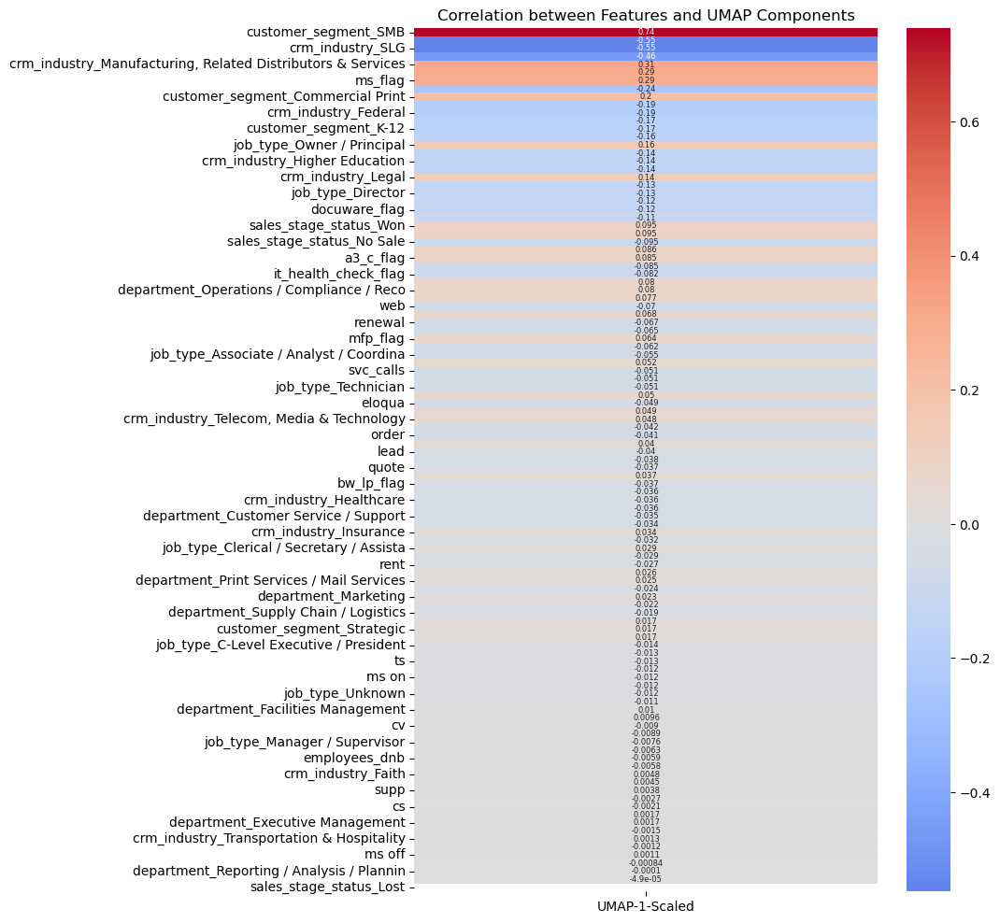

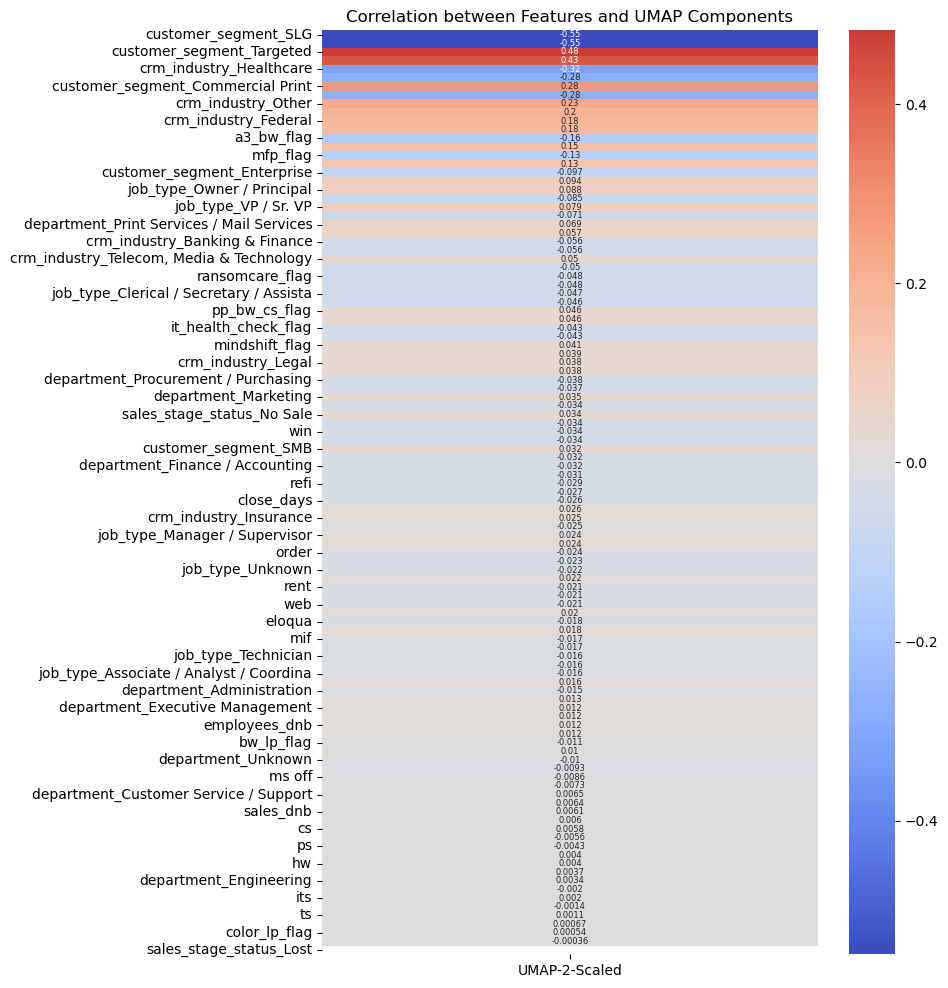

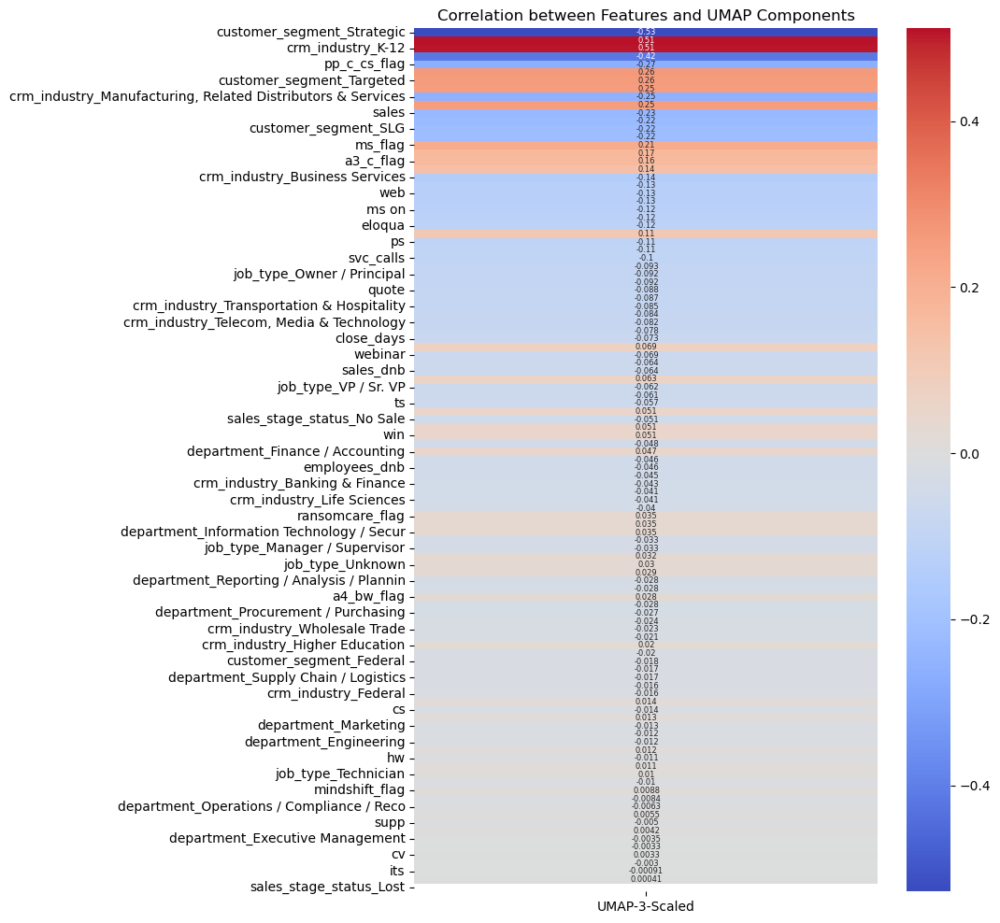

In [58]:
# plot correlation of features and umap coordimates 3d -- sort by abs values
umap_df = pd.concat([X_features.reset_index(drop=True), X_umap_3d_scaled], axis=1)
umap_corr = umap_df.corr().loc[:, 'UMAP-1-Scaled':'UMAP-3-Scaled'].drop(['UMAP-1-Scaled', 'UMAP-2-Scaled','UMAP-3-Scaled'])

# print(umap_corr)
for i in range(1, 4):  
    plt.figure(figsize=(8, 12))
    axis = 'UMAP-' + str(i) + '-Scaled'
    sns.heatmap(umap_corr[[axis]].sort_values(by = axis, key=abs, ascending = False), annot=True, cmap='coolwarm', center=0, annot_kws={"size": 6})
    plt.title('Correlation between Features and UMAP Components')
    plt.show()

In [59]:
# fine tune 
hdb = hdbscan.HDBSCAN(gen_min_span_tree=True).fit(X_umap_scaled)

param_dist = {'min_samples': [60,80,100,120,150,200],
              'min_cluster_size':[200,250,300,350,400,500],  
              'cluster_selection_method' : ['eom','leaf'],
              'metric' : ['euclidean','manhattan'] 
             }

#validity_scroer = "hdbscan__hdbscan___HDBSCAN__validity_index"
validity_scorer = make_scorer(hdbscan.validity.validity_index,greater_is_better=True)


n_iter_search = 20
random_search = RandomizedSearchCV(hdb
                                   ,param_distributions=param_dist
                                   ,n_iter=n_iter_search
                                   ,scoring=validity_scorer 
                                   ,random_state=42)

random_search.fit(X_umap_3d_scaled)


print(f"Best Parameters {random_search.best_params_}")
print(f"DBCV score :{random_search.best_estimator_.relative_validity_}")

Best Parameters {'min_samples': 120, 'min_cluster_size': 250, 'metric': 'manhattan', 'cluster_selection_method': 'leaf'}
DBCV score :0.45009080919035543


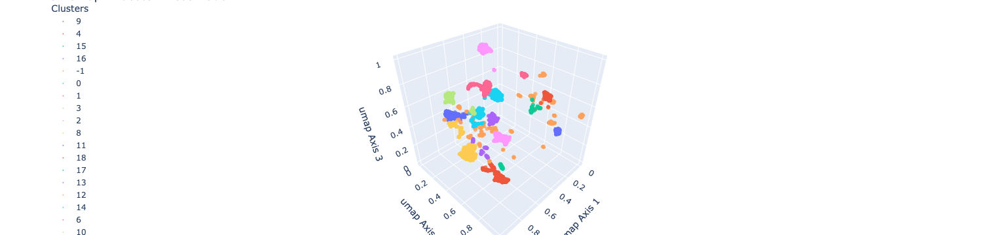

In [61]:
# check on silleute: 
hdb = hdbscan.HDBSCAN(min_samples = 120, min_cluster_size = 250, cluster_selection_method = 'leaf', gen_min_span_tree=True)
hdb_label = hdb.fit_predict(X_umap_3d_scaled)
silhouette_score(X_umap_3d_scaled, hdb_label)

X_umap_3d['hdbscan_label'] = hdb_label

plot_3d(X_umap_3d, 'UMAP-1-Scaled', 'UMAP-2-Scaled','UMAP-3-Scaled', 'umap', 'hdbscan')

In [62]:
shs(X_umap_3d_scaled, hdb_label)

0.5899055

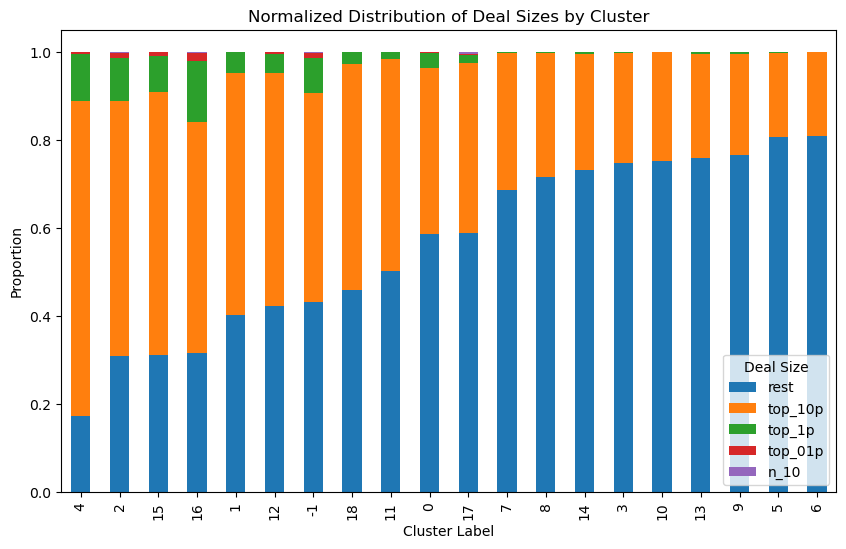

In [63]:
plot_cluster_hist(X_umap_3d, 'hdbscan')

In [64]:
db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_umap_3d, 'hdbscan', 16)

ms off                                     194.707768
cs                                        -191.213092
ms on                                      177.260696
department_Environmental Sustainability    167.773527
sales_dnb                                  166.430449
ps                                         160.862752
ransomcare_flag                           -158.052184
employees_dnb                              155.226909
rent                                       154.396673
Name: mean, dtype: float64
close_days                                   8.940919
job_type_Technician                          7.236596
pp_c_cs_flag                                 6.640566
department_Unknown                           5.407799
job_type_Unknown                             4.521480
department_Sales                             3.799031
job_type_Director                            3.130703
a4_c_flag                                   -2.389395
department_Information Technology / Secur    0.074660
s

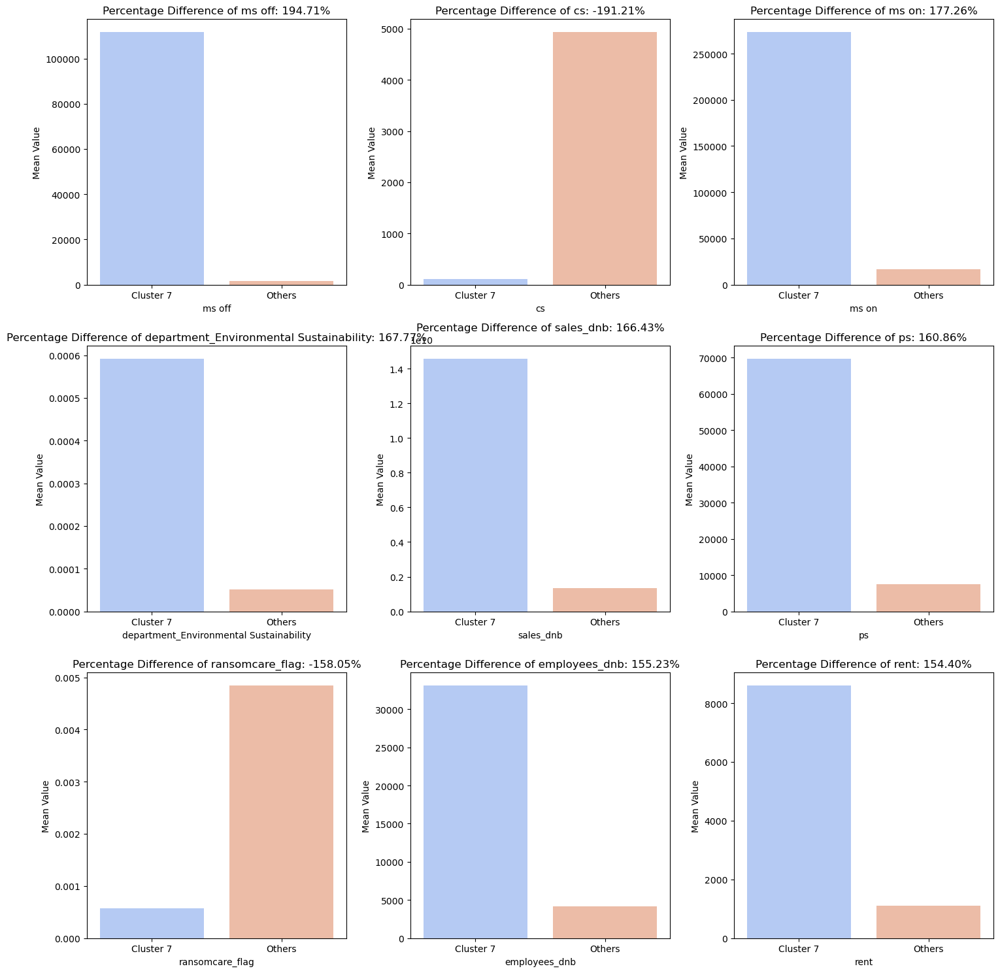

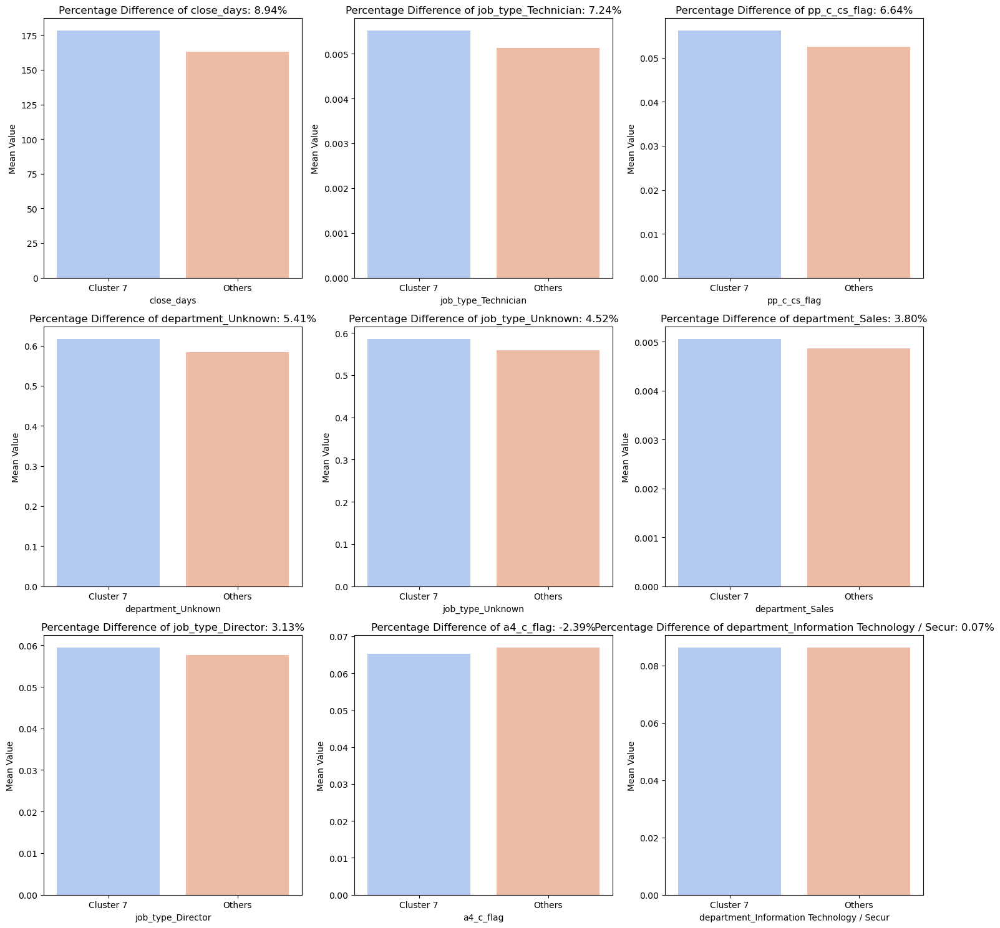

In [65]:
#db2_summary, dbo_summary, most_different_features, least_different_features = generate_summary(X_umap_3d, 'hdbscan', 7)
plot_summary(most_different_features, db2_summary, dbo_summary, 7)
plot_summary(least_different_features, db2_summary, dbo_summary, 7)

In [68]:
X_full = X_features.copy()
X_full['hdbscan_label_3d'] = l2['hdbscan_label_3d']
cluster_means = X_full.groupby('hdbscan_label_3d').mean()
overall_means = X.mean()
feature_importance = cluster_means - overall_means

sorted_importance = feature_importance.sort_values(by=list(feature_importance.columns), ascending=False)

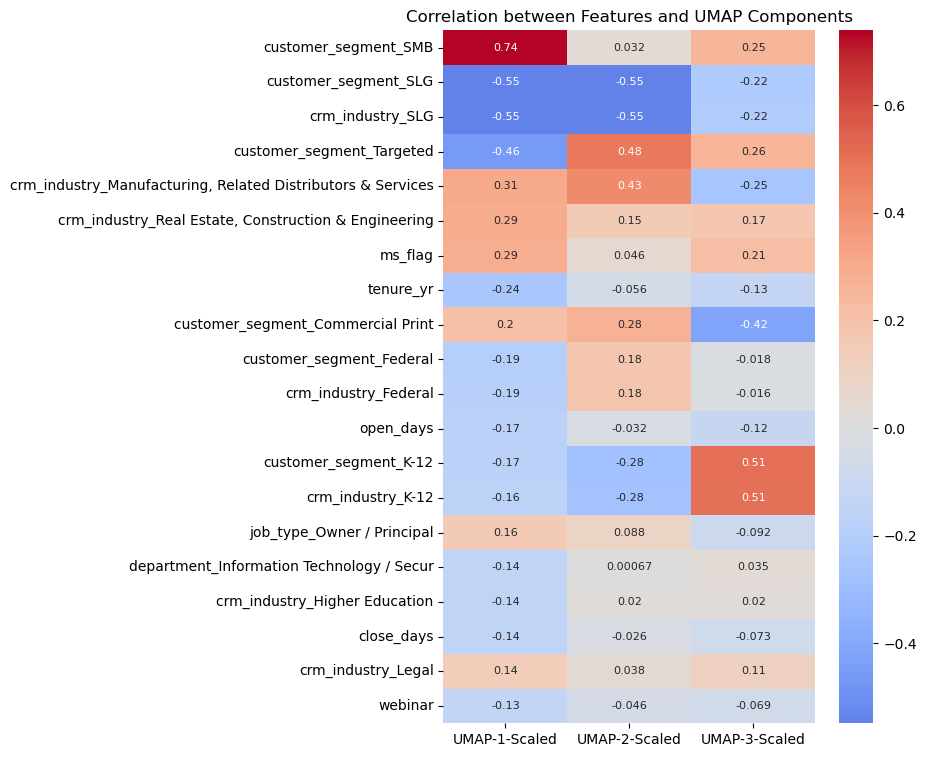

In [70]:
umap_df = pd.concat([X_features.reset_index(drop=True), X_umap_3d_scaled], axis=1)
umap_corr = umap_df.corr().loc[:, 'UMAP-1-Scaled':'UMAP-3-Scaled'].drop(['UMAP-1-Scaled', 'UMAP-2-Scaled','UMAP-3-Scaled'])
#print(umap_corr)

plt.figure(figsize=(6, 9))
sns.heatmap(umap_corr.sort_values(by = 'UMAP-1-Scaled', key=abs, ascending = False).head(20), annot=True, cmap='coolwarm', center=0, annot_kws={"size": 8})
plt.title('Correlation between Features and UMAP Components')
plt.show()

In [72]:
umap_corr

,UMAP-1-Scaled,UMAP-2-Scaled,UMAP-3-Scaled
employees_dnb,-0.005943,0.011776,-0.045846
sales_dnb,-0.002667,0.006116,-0.063583
eloqua,-0.049023,-0.018094,-0.116512
eloqua oc,-0.062433,-0.022501,-0.028033
lead,-0.039843,0.003664,-0.078208
opp,-0.041585,-0.016014,-0.091744
order,-0.040979,-0.023957,-0.093060
quote,-0.037474,-0.016838,-0.088455
sales,-0.106692,-0.034187,-0.228313
web,-0.069616,-0.020501,-0.132898


## Spectural

In [ ]:
se = manifold.SpectralEmbedding(
    n_components=2, n_neighbors=n_neighbors, random_state=42
)
trans_data = se.fit_transform(X).T
t1 = time()
print("Spectral Embedding: %.2g sec" % (t1 - t0))

ax = fig.add_subplot(259)
plt.scatter(X[0], X[1], c=colors, cmap=plt.cm.rainbow)
plt.title("Spectral Embedding (%.2g sec)" % (t1 - t0))
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
plt.axis("tight")